
# <center>                    CREDIT EXPLORATORY DATA ANALYSIS - CASE STUDY </center>


### CREDIT EDA PROCESS STEPS FOLLOWED IN THIS NOTEBOOK

    1.	Import libraries and datasets 
    2.	Check the Structure of Df 
    3.	Data Quality check and Missing values
        a.	Percentage of missing values of all cols
        b.	Remove cols with high missing % (>50)
        c.	<=13% missing values cols provides suggestions for imputing missing values
        d.	Data type check and change the data types for 10 cols
        e.	Numerical cols - Check for outliers and report for 5 variables
        f.	Continuous variables Binning.
    4. Analysis
        a.	Data Imbalance %
        b.	Split data sets into 2.
        c.	Categorical Variable Analysis:
            i.	Univariate and Bivariate for Target 0 & 1.
            ii.	Comparison of target variable across categories of Category variables.
        d.	Numerical Variable Analysis:
            i.	Correlation for Numerical cols for Target 0 & 1
            ii.	Univariate and Bivariate for Target 0 & 1.
            iii.	Comparison of target variable across categories of Category variables.
    5. Previous Application
        a. Merge both appl datasets
        b. Perform Univariate and Bivariate analysis
    6. Conclusion


<br>CONTENTS:
1. [BUSINESS UNDERSTANDING](#1)
1. [DATA EXPLORATION](#2)
    1. [DATASET - CURRENT APPLICATION](#3)
        1. [SHAPE OF THE DATASET](#4)
        1. [IDENTIFYING THE DATA TYPES](#5)
        1. [QUALITY OF THE DATASET](#6)
            1. [MISSING VALUE](#7)
            1. [DATATYPE CHECK](#8)
            1. [OUTLIER DETECTION](#9)
            1. [BINNING](#10)
        1. [ANALYSIS](#11)
            1. [DATA IMBALANCE](#12)
            1. [DIVIDING DATASET](#13)
            1. [UNI-VARIATE ANALYSIS](#14)
            1. [CORRELATION MATRIX](#17)
            1. [BI - VARIATE ANALYSIS](#18)
     1. [DATASET - PREVIOUS APPLICATION](#19)
     1. [DATASET - MERGED FINAL](#20)
        1. [IDENTIFYING THE DATA TYPES](#21)
        1. [SHAPE OF THE DATASET](#22)
        1. [QUALITY OF THE DATASET](#23)
            1. [MISSING VALUE](#24)
            1. [DATATYPE CHECK](#25)
            1. [OUTLIER DETECTION](#26)
            1. [BINNING](#27)
        1. [ANALYSIS](#28)
            1. [DATA IMBALANCE](#29)
            1. [DIVIDING DATASET](#30)
            1. [UNI-VARIATE ANALYSIS](#31)
            1. [CORRELATION MATRIX](#32)
            1. [BI - VARIATE ANALYSIS](#33)
1. [FINAL CONCLUSION](#34)

<a id ="1"></a>
## BUSINESS UNDERSTANDING:

Our aim in this case study is to identify patterns which indicate if a client has difficulty paying their installments which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc. This will ensure that the consumers capable of repaying the loan are not rejected. Identification of such applicants using EDA is the aim of this case study.

In other words, the company wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default.  The company can utilise this knowledge for its portfolio and risk assessment.


<a id="2"></a> <br>
## DATA EXPLORATION:

We will start with importing the data, till giving the conclusion of what the data said

<a id="3"></a> <br>
### DATASET - CURRENT APPLICATION:

In [1]:
# Importing necessary libraries in to the notebook

import numpy as np,pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as px
import plotly.express as pxx
import plotly.graph_objects as go
from scipy import stats

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Reading the CSV file named 'application_data' as current_application DataFrame
#path_dir = r'C:\Users\Admin\Downloads\\'
current_application = pd.read_csv('application_data.csv')
pd.set_option('display.max_columns', 200) 
current_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

<a id="4"></a>
### SHAPE OF THE DATASET:


In [3]:
print('Shape of application Data:',current_application.shape)

Shape of application Data: (307511, 122)


<a id="5"></a> <br>
### IDENTIFYING THE DATA TYPES:
Now, lets understand the data captured in two Dataframes more briefly by getting the *info*

In [4]:
print(current_application.info(verbose=True, null_counts=True))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   SK_ID_CURR                    307511 non-null  int64  
 1   TARGET                        307511 non-null  int64  
 2   NAME_CONTRACT_TYPE            307511 non-null  object 
 3   CODE_GENDER                   307511 non-null  object 
 4   FLAG_OWN_CAR                  307511 non-null  object 
 5   FLAG_OWN_REALTY               307511 non-null  object 
 6   CNT_CHILDREN                  307511 non-null  int64  
 7   AMT_INCOME_TOTAL              307511 non-null  float64
 8   AMT_CREDIT                    307511 non-null  float64
 9   AMT_ANNUITY                   307499 non-null  float64
 10  AMT_GOODS_PRICE               307233 non-null  float64
 11  NAME_TYPE_SUITE               306219 non-null  object 
 12  NAME_INCOME_TYPE              307511 non-nu

### Insights about the Structure of Current Application Dataset

Shape of Current application Data: (307511, 122)

- Data types (int64,float64,object) \- Application dataset:(41,65,60)
- We see lot of statistical data values with \_AVG,\_MEDI and \_MODE suffixed in the column names

<a id="6"></a>
## QUALITY OF THE DATASET:

<a id="7"></a>
### MISSING VALUE:

Finding how many columns are having more than 50% of the NaN values

In [5]:
emptycolumn_finder=current_application.isnull().sum()
emptycolumn = emptycolumn_finder[(emptycolumn_finder.values>=0.5*len(current_application))]
l=len(emptycolumn)
print('It is understood that totally {0} columns are to be removed'.format(l))

It is understood that totally 41 columns are to be removed


In [6]:
#Function to return the Percentage and Total Missing data by Column
def MissingData(df):
    tot = df.isnull().sum().sort_values(ascending = False)
    p = (df.isnull().sum()/df.isnull().count()*100).sort_values(ascending = False)
    return pd.concat([tot, p], axis=1, keys=['Total', 'Percentage'])

### Percentage of missing values for Current Bank Application Dataset

In [7]:
current_appl_missing = MissingData(current_application)
print('Below are the percentage of missing values that are greater than 50%')
print(current_appl_missing[current_appl_missing['Percentage']>50])

Below are the percentage of missing values that are greater than 50%
                           Total  Percentage
COMMONAREA_MEDI           214865   69.872297
COMMONAREA_AVG            214865   69.872297
COMMONAREA_MODE           214865   69.872297
NONLIVINGAPARTMENTS_MODE  213514   69.432963
NONLIVINGAPARTMENTS_MEDI  213514   69.432963
NONLIVINGAPARTMENTS_AVG   213514   69.432963
FONDKAPREMONT_MODE        210295   68.386172
LIVINGAPARTMENTS_MEDI     210199   68.354953
LIVINGAPARTMENTS_MODE     210199   68.354953
LIVINGAPARTMENTS_AVG      210199   68.354953
FLOORSMIN_MEDI            208642   67.848630
FLOORSMIN_MODE            208642   67.848630
FLOORSMIN_AVG             208642   67.848630
YEARS_BUILD_MEDI          204488   66.497784
YEARS_BUILD_AVG           204488   66.497784
YEARS_BUILD_MODE          204488   66.497784
OWN_CAR_AGE               202929   65.990810
LANDAREA_MODE             182590   59.376738
LANDAREA_AVG              182590   59.376738
LANDAREA_MEDI             18259

In [8]:
# Removing columns which are having more than 50% null values on the whole
current_application.drop(labels=list(emptycolumn.index),axis=1,inplace=True)

In [9]:
# Inspecting the Dataframe after removing the NaN columns
current_application.shape

(307511, 81)

### Insights on Missing Values:
- We could see from the above that Current application has 40+ columns in the dataset that have got NA greater than 50%.
- There are more than 120 columns in the Current application dataset, it will be very difficult to look at each and every column and analyze the NA or missing values. 
- As it is not feasable to impute NA/missing values for these columns, We will be removing these columns.

### Note:
Missing Value Columns which are greater than 50% has been removed. However there are still columns exist that are less than 50%.  Lets take a look of that too. 

In [10]:
# Finding columns having less than 50% Null Values

lessthan_50=list(current_application.loc[:-1,(current_application.isnull().sum().values>0)].columns)
for i in lessthan_50:
    print(" {0} has {1} percentage of null values".format(i,round(current_application[i].isnull().sum()/len(current_application)*100,4)))

 AMT_ANNUITY has 0.0039 percentage of null values
 AMT_GOODS_PRICE has 0.0904 percentage of null values
 NAME_TYPE_SUITE has 0.4201 percentage of null values
 OCCUPATION_TYPE has 31.3455 percentage of null values
 CNT_FAM_MEMBERS has 0.0007 percentage of null values
 EXT_SOURCE_2 has 0.2146 percentage of null values
 EXT_SOURCE_3 has 19.8253 percentage of null values
 YEARS_BEGINEXPLUATATION_AVG has 48.781 percentage of null values
 FLOORSMAX_AVG has 49.7608 percentage of null values
 YEARS_BEGINEXPLUATATION_MODE has 48.781 percentage of null values
 FLOORSMAX_MODE has 49.7608 percentage of null values
 YEARS_BEGINEXPLUATATION_MEDI has 48.781 percentage of null values
 FLOORSMAX_MEDI has 49.7608 percentage of null values
 TOTALAREA_MODE has 48.2685 percentage of null values
 EMERGENCYSTATE_MODE has 47.3983 percentage of null values
 OBS_30_CNT_SOCIAL_CIRCLE has 0.332 percentage of null values
 DEF_30_CNT_SOCIAL_CIRCLE has 0.332 percentage of null values
 OBS_60_CNT_SOCIAL_CIRCLE has 0.

So the above columns are identified with their corresponding null percentage values, lets try to analyze these columns and provide some recommendations for Imputing those Missing values.

There are 41 columns which are having less than 50% null values, but we are going to suggest for the columns which are having less than 13% null values columns 

In [11]:
# Finding the null value columns

emptycolumn_finder=current_application.isnull().sum()
emptycolumn = emptycolumn_finder[(emptycolumn_finder.values<=0.13*len(current_application)) & (emptycolumn_finder.values>0.0*len(current_application))]
for i in range(len(emptycolumn)):
    print(emptycolumn.index[i],emptycolumn[i],current_application[emptycolumn.index[i]].dtypes)

AMT_ANNUITY 12 float64
AMT_GOODS_PRICE 278 float64
NAME_TYPE_SUITE 1292 object
CNT_FAM_MEMBERS 2 float64
EXT_SOURCE_2 660 float64
OBS_30_CNT_SOCIAL_CIRCLE 1021 float64
DEF_30_CNT_SOCIAL_CIRCLE 1021 float64
OBS_60_CNT_SOCIAL_CIRCLE 1021 float64
DEF_60_CNT_SOCIAL_CIRCLE 1021 float64
DAYS_LAST_PHONE_CHANGE 1 float64


In [12]:
# printing the values for outlier recommendations

print("AMT_ANNUITY column has median as ",current_application.AMT_ANNUITY.median())
print("AMT_GOODS_PRICE  column has median as ",current_application.AMT_GOODS_PRICE.median())
print("NAME_TYPE_SUITE  column has mode as ",current_application.NAME_TYPE_SUITE.mode().values[0])
print("CNT_FAM_MEMBERS column has median as ",current_application.CNT_FAM_MEMBERS.median())
print("DAYS_LAST_PHONE_CHANGE column has median as ",current_application.DAYS_LAST_PHONE_CHANGE.median())

AMT_ANNUITY column has median as  24903.0
AMT_GOODS_PRICE  column has median as  450000.0
NAME_TYPE_SUITE  column has mode as  Unaccompanied
CNT_FAM_MEMBERS column has median as  2.0
DAYS_LAST_PHONE_CHANGE column has median as  -757.0


### Suggestions for Impute Missing values:

1. For Categorical column NAME_TYPE_SUITE, We have to use most frequently occuring value or Mode for Imputing missing values. Here in most cases "Unaccompanied" is repeated .Therefore we recommend to impute "Unaccompanied" to missing values in this column.
2. For Numerical coulmns AMT_ANNUITY & AMT_GOODS_PRICE, we have used boxplot and could see that there are any outliers. So we recommend to impute the Median value to missing values in these two columns.


<a id ="8"></a>
### DATATYPE CHECK:

In [13]:
# Changing the datatypes of the columns and creating a column to make it handy for further analysis 

#converting the age to year. Assuming a year got 365 days
#Assuming client with DAYS_BIRTH value of -365 is 1 year old
current_application['AGE_OF_APPLICANT'] = abs(current_application.DAYS_BIRTH/365).astype(int)

current_application['DAYS_EMPLOYED']=abs(current_application.DAYS_EMPLOYED).astype(int)
current_application['DAYS_ID_PUBLISH']=abs(current_application['DAYS_ID_PUBLISH']).astype(int)
current_application['DAYS_REGISTRATION']=abs(current_application['DAYS_REGISTRATION']).astype(int)

current_application.TARGET = current_application.TARGET.astype(str)
current_application.DAYS_BIRTH = abs(current_application.DAYS_BIRTH).astype('int64')
current_application.FLAG_MOBIL = current_application.FLAG_MOBIL.astype(str)
current_application.FLAG_EMP_PHONE = current_application.FLAG_EMP_PHONE.astype(str)
current_application.FLAG_WORK_PHONE = current_application.FLAG_WORK_PHONE.astype(str)
current_application.FLAG_CONT_MOBILE = current_application.FLAG_CONT_MOBILE.astype(str)
current_application.FLAG_CONT_MOBILE = current_application.FLAG_CONT_MOBILE.astype(str)
current_application.FLAG_PHONE = current_application.FLAG_PHONE.astype(str)
current_application.FLAG_EMAIL = current_application.FLAG_EMAIL.astype(str)
current_application.FLAG_DOCUMENT_2 = current_application.FLAG_DOCUMENT_2.astype(str)

In [14]:
# Checking the Datatypes after change

print(current_application.info(verbose=True, null_counts=True))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 82 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   SK_ID_CURR                    307511 non-null  int64  
 1   TARGET                        307511 non-null  object 
 2   NAME_CONTRACT_TYPE            307511 non-null  object 
 3   CODE_GENDER                   307511 non-null  object 
 4   FLAG_OWN_CAR                  307511 non-null  object 
 5   FLAG_OWN_REALTY               307511 non-null  object 
 6   CNT_CHILDREN                  307511 non-null  int64  
 7   AMT_INCOME_TOTAL              307511 non-null  float64
 8   AMT_CREDIT                    307511 non-null  float64
 9   AMT_ANNUITY                   307499 non-null  float64
 10  AMT_GOODS_PRICE               307233 non-null  float64
 11  NAME_TYPE_SUITE               306219 non-null  object 
 12  NAME_INCOME_TYPE              307511 non-nul

<a id="9"></a>
### OUTLIER DETECTION:

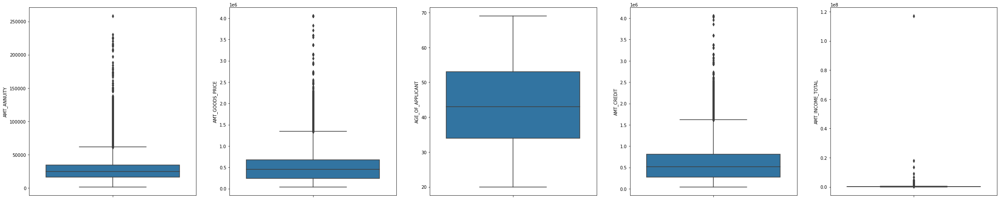

In [15]:
# Plotting the outlier present using boxplot

fig,axes = plt.subplots(ncols=5,nrows=1,figsize=(40,8))
ax1=sns.boxplot(y=current_application.AMT_ANNUITY,ax=axes[0])
ax2=sns.boxplot(y=current_application.AMT_GOODS_PRICE,ax=axes[1])
ax3=sns.boxplot(y=current_application.AGE_OF_APPLICANT,ax=axes[2])
ax4=sns.boxplot(y=current_application.AMT_CREDIT,ax=axes[3])
ax5=sns.boxplot(y=current_application.AMT_INCOME_TOTAL,ax=axes[4])
plt.show()

In [16]:
# Finding the quartiles of DAYS_EMPLOYED column

current_application.DAYS_EMPLOYED.quantile([0.5,0.75,0.9,0.95,0.99,1])

0.50      2219.0
0.75      5707.0
0.90    365243.0
0.95    365243.0
0.99    365243.0
1.00    365243.0
Name: DAYS_EMPLOYED, dtype: float64

In [17]:
# Finding the quartiles of AMT_ANNUITY column

current_application.AMT_ANNUITY.quantile([0.5,0.75,0.9,0.95,0.99,1])

0.50     24903.0
0.75     34596.0
0.90     45954.0
0.95     53325.0
0.99     70006.5
1.00    258025.5
Name: AMT_ANNUITY, dtype: float64

In [18]:
# Finding the quartiles of AMT_CREDIT column

current_application.AMT_CREDIT.quantile([0.5,0.75,0.9,0.95,0.99,1])

0.50     513531.0
0.75     808650.0
0.90    1133748.0
0.95    1350000.0
0.99    1854000.0
1.00    4050000.0
Name: AMT_CREDIT, dtype: float64

In [19]:
# Finding the quartiles of AMT_INCOME_TOTAL column

current_application.AMT_INCOME_TOTAL.quantile([0.5,0.75,0.9,0.95,0.99,1])

0.50       147150.0
0.75       202500.0
0.90       270000.0
0.95       337500.0
0.99       472500.0
1.00    117000000.0
Name: AMT_INCOME_TOTAL, dtype: float64

### Description/Recommendations for Outliers:
 1. We can see that there are clear signs of outliers in the current application for chosen Numerical Columns like DAYS_EMPLOYED, AMT_ANNUITY, AMT_GOODS_PRICE, AMT_CREDIT and AMT_INCOME_TOTAL.
 2. By looking at the quantile values for DAYS_EMPLOYED, we could see that from 90 quantile onwards the days are 365243 i.e; coming around 1000 years. These are outliers and created due to human error or system error.

<a id="10"></a>
### BINNING:

In [20]:
# By using pd.cut, column 'AMT_INCOME_TOTAL' has been sliced to infuse into the range we create

#bins = [0, 25000, 50000, 75000, 100000, 125000, 150000, 175000, 200000, 225000, 250000, 275000, 300000, 325000, 350000, 375000, 400000, 425000, 450000, 475000, 500000,600000, 10000000000]
#bins_range = ['0-25000', '25000-50000','50000-75000','75000-100000','100000-125000', '125000-150000', '150000-175000','175000-200000',
#       '200000-225000','225000-250000','250000-275000','275000-300000','300000-325000','325000-350000','350000-375000',
#       '375000-400000','400000-425000','425000-450000','450000-475000','475000-500000','500000-600000','600000 and above']
bins = [0, 100000, 200000, 300000, 500000,round(max(current_application['AMT_INCOME_TOTAL']))]
bins_range = ['0-100000', '100000-200000', '200000-300000', '300000-500000', '500000 and above']
current_application['INCOME_RANGE']=pd.cut(current_application['AMT_INCOME_TOTAL'],bins=bins,labels=bins_range)

In [21]:
# By using pd.cut, column 'AMT_CREDIT' has been sliced to infuse into the range we create

#bins = [0, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000, 550000, 600000, 650000, 700000, 750000, 800000, 850000, 900000,1000000, 1000000000]
#bins_range = ['0-150000', '150000-200000','200000-250000', '250000-300000', '300000-350000', '350000-400000','400000-450000',
#        '450000-500000','500000-550000','550000-600000','600000-650000','650000-700000','700000-750000','750000-800000',
#        '800000-850000','850000-900000','900000-1000000','1000000 and above']

bins = [0, 100000, 300000, 500000, 1000000,round(max(current_application['AMT_CREDIT']))]
labels = ['0-100000', '100000-300000', '300000-500000', '500000-1000000', '1000000 and above']

current_application['CREDIT_RANGE']=pd.cut(current_application['AMT_CREDIT'],bins=bins,labels=bins_range)

<a id="11"></a>
## ANALYSIS:

<a id="12"></a>
### DATA IMBALANCE:

In [22]:
# Finding Imbalance parameters of the dataset

round(current_application.TARGET.value_counts(normalize=True)*100,2)

0    91.93
1     8.07
Name: TARGET, dtype: float64

In [23]:
# Function to create Pie
def plot_pie(col,df,ttl):
    temp = df[col].value_counts()
    df = pd.DataFrame({'labels': temp.index,'values': temp.values})
    plt.title(ttl)
    plt.pie(df['values'], labels=df['labels'].unique(), autopct='%1.2f%%', shadow=True)

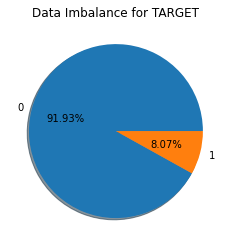

In [24]:
# Pie plot to visualize the data for TARGET variable
plot_pie('TARGET',current_application,'Data Imbalance for TARGET')

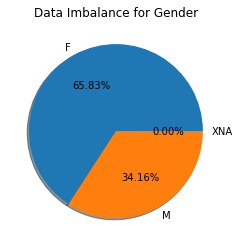

In [25]:
# Pie plot to visualize the data for Gender variable
plot_pie('CODE_GENDER',current_application,'Data Imbalance for Gender')

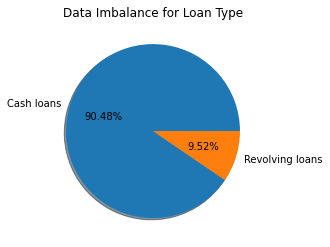

In [26]:
# Pie plot to visualize the data for Loan Type variable
plot_pie('NAME_CONTRACT_TYPE',current_application,'Data Imbalance for Loan Type')

### Insights on Data Imbalance 
- For TARGET variable, we see that around 8% of the clients have payment difficulties (Target 1)
- For CODE_GENDER variable,we see 3 gender categories 
   - We see that ~66% of the clients are Females
   - M vs F ratio is nearly double  
- For NAME_CONTRACT_TYPE variable, 
    - We see that there are 2 types of Loans 1. Cash Loans 2. Revolving Loans
    - 'Revolving loans' coming around 10% in the total number of loans and remaining percentage of loans are Cash Loans.

<a id="13"></a>
### DIVIDING DATASET:  

In [27]:
# Creating new dataframe with Target 0
CLIENT_WITH_OTHER_CASES_pre=current_application[(current_application.TARGET=='0')]

# Creating another dataframe with Target 1
CLIENT_WITH_PAYMENT_DIFFICULTIES_pre=current_application[(current_application.TARGET=='1')]

<a id="14"></a>
## UNI-VARIATE ANALYSIS:

<a id="15"></a>
### UNI-VARIATE CATEGORICAL:

In [28]:
# Defining boxplot with needed parameters
def unibarplot(data1,data2,col,title,label):
    fig,ax=plt.subplots(1,2, figsize=(30,20))
        
    
#Setting up the style and contexts
    fig.suptitle(title.upper(),weight='bold',fontsize=20)

#Assigning the axes and its values 
    ax1 = plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.2)
    ax1 = sns.countplot(x=data1[col],ax=ax[0],palette='mako')
    #ax1 = sns.countplot(x=col,hue='TARGET',ax=ax[0],data = current_application,palette='mako')
    ax1.set_ylabel('Count'.upper())
    ax1.set_xlabel(label.upper(),fontsize=28)
    ax1.set_xticklabels(ax1.get_xticklabels(),rotation=60,fontsize=16)
    ax1.set_title('For Target 0'.upper())
    
    ax2 = plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.2)
    ax2 = sns.countplot(x=data2[col],ax=ax[1],palette='mako')
    ax2.set_ylabel('Count'.upper())
    ax2.set_xlabel(label.upper(),fontsize=28)
    ax2.set_xticklabels(ax2.get_xticklabels(),rotation=60,fontsize=16)
    ax2.set_title('For Target 1'.upper())
    
    
    plt.tight_layout()
#     plt.savefig(label+col)
    plt.show()
    

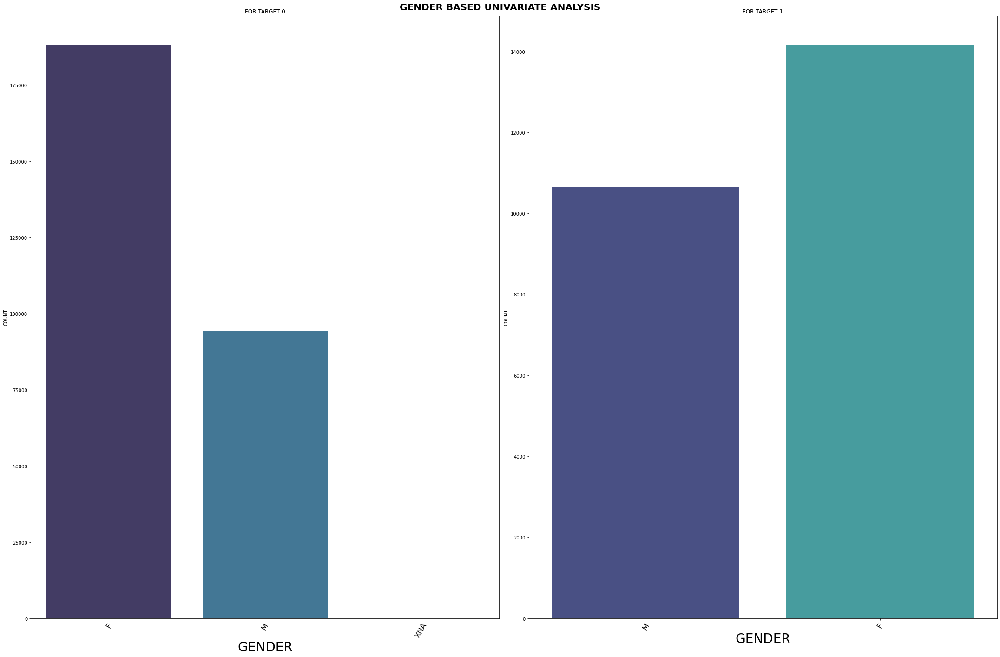

In [29]:
# Plotting the chart using function

unibarplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='CODE_GENDER',title='Gender based univariate Analysis',label='Gender')

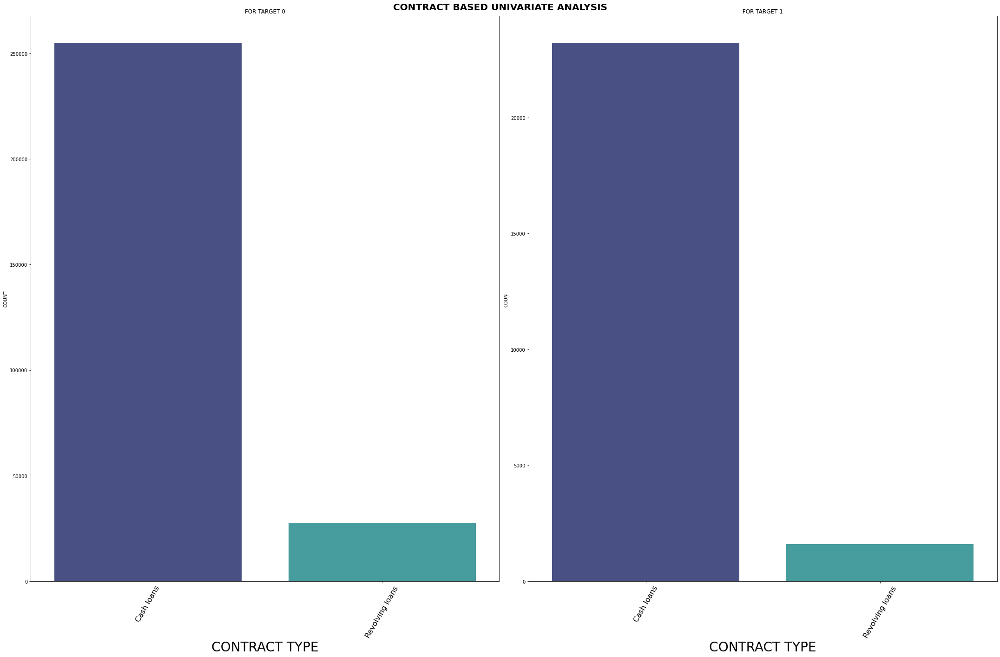

In [30]:
# Plotting the chart using function

unibarplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='NAME_CONTRACT_TYPE',title='Contract based univariate Analysis',label='Contract Type')

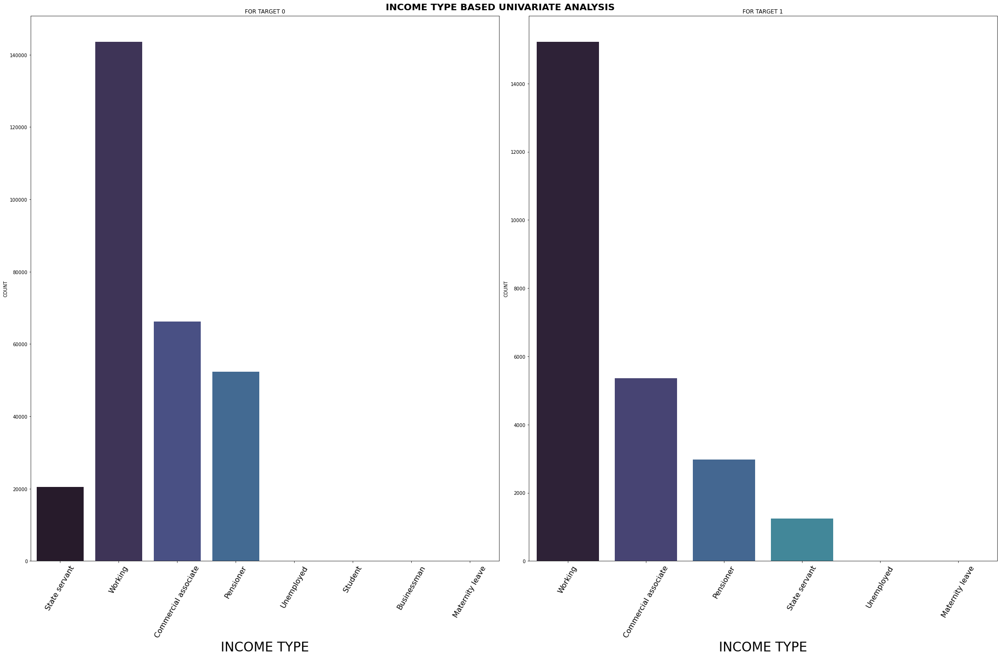

In [31]:
# Plotting the chart using function

unibarplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='NAME_INCOME_TYPE',title='Income type based univariate Analysis',label='Income Type')


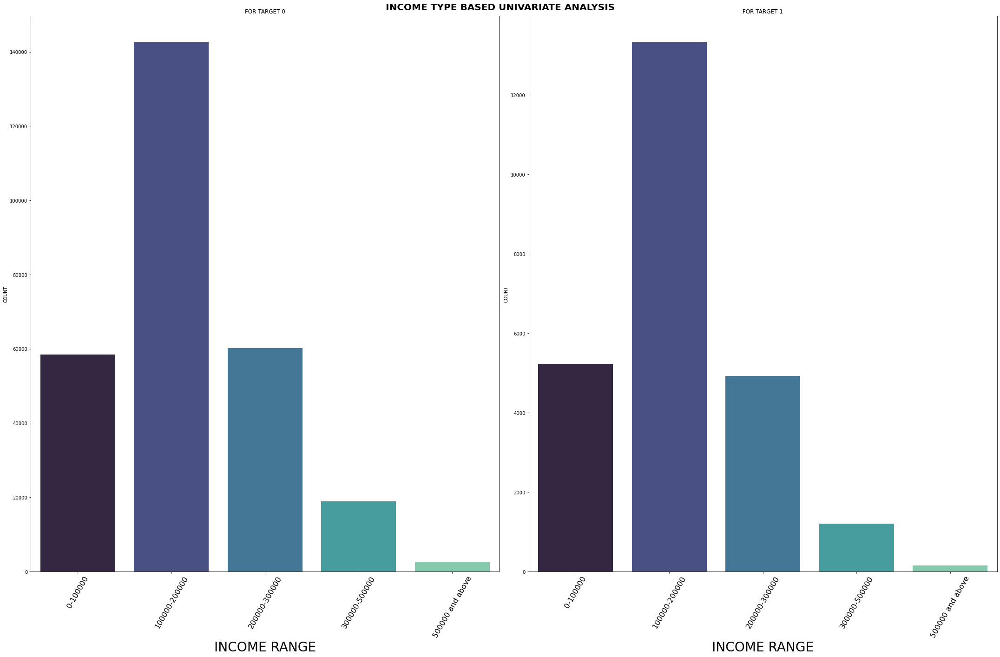

In [32]:
# Plotting the chart using function

unibarplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='INCOME_RANGE',title='Income type based univariate Analysis',label='Income Range')

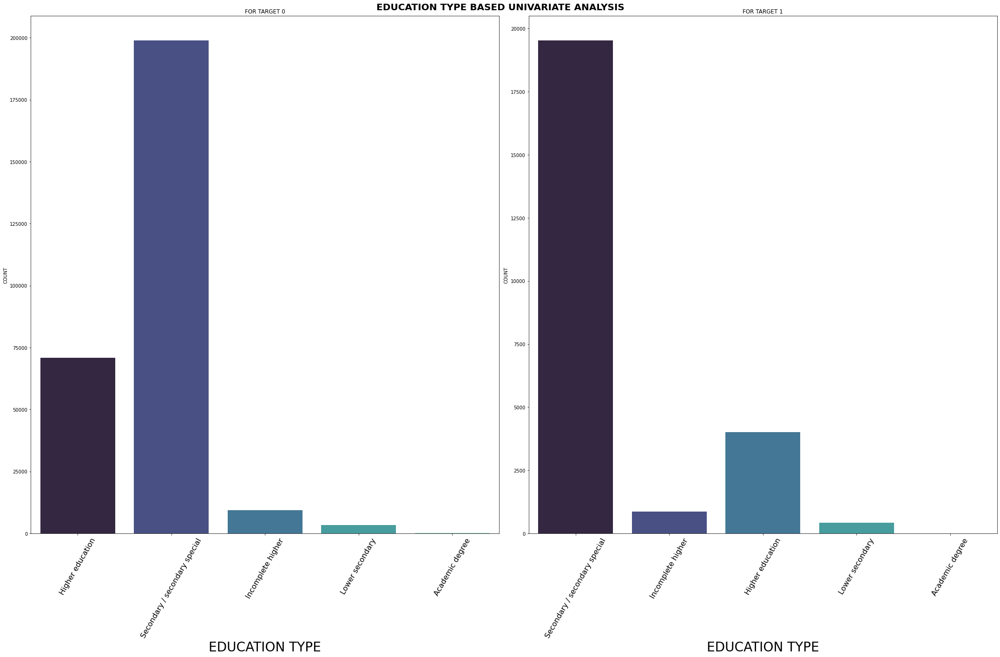

In [33]:
# Plotting the chart using function

unibarplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='NAME_EDUCATION_TYPE',title='Education type based univariate Analysis',label='Education type')

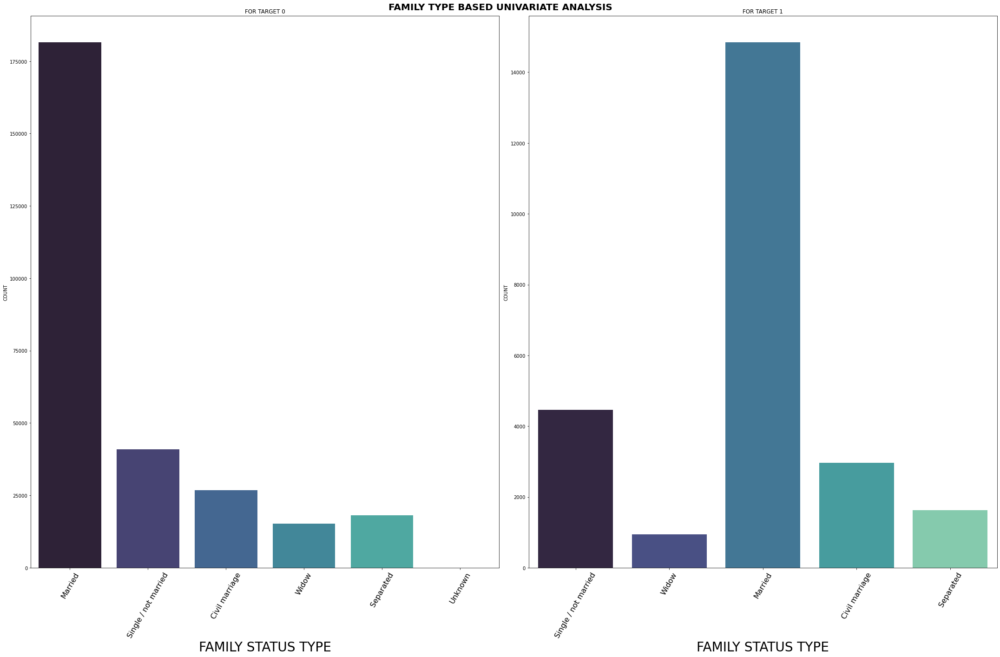

In [34]:
# Plotting the chart using function

unibarplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='NAME_FAMILY_STATUS',title='Family type based univariate Analysis',label='Family status type')


***Insights from the above plots:***
1. We can see that Number of Female has taken more loans when compared to Male.
2. Male clients have slightly higher difficulties in Loan Payment.
3. As we have sen earlier in the Data imbalance section, Cash Loans (90%) are very higher when compared to Revolving Loans (10%) in both TARGET 0 and 1.
4. Number of Cash Loans in Target 0 is greater than 250k whereas the number of cash loans in Target 1 is 25k
5. Most Number of loans are given to 'Working' categories followed by 'Commercial associates' and 'State servant’.
6. Loans are not sanctioned or very less number sanctioned for 'Student', 'UnEmployed', 'Maternity Leave' and 'Businessman'.
7. Most Number of loans are given for client/customer who has completed Secondary Education and it is followed by client wh has completed Higher Education.
8. More number of Clients who has Payment difficulties are in Secondary Education category. Clients with Higher Education degree has better chances of Loan Payment when compared to Secondary Education Client.
9. Most Number of loans are given to 'Married' persons followed by 'Single/Not Married' and 'Civil Marriage’ in both Target  0 and 1.
10. Interestingly, more number of clients who are 'Married' has higher difficulty in Loan repayment and it is followed by 'Single/Not Married' and 'Civil Marriage’.
11. However if we total/add the number of Clients in Target 0 and 1 for 'Married' Persons then the percentage of Loan default rate or payment difficulty reduces.

<a id="17"></a>
### CORRELATION MATRIX:

In [35]:
# Finding the Correlation for Target 0

CLIENT_WITH_OTHER_CASES_pre.corr().style.background_gradient(cmap='YlGnBu').set_precision(2)

In [36]:
# Finding the Correlation for Target 1

CLIENT_WITH_PAYMENT_DIFFICULTIES_pre.corr().style.background_gradient(cmap='YlGnBu').set_precision(2)

### Top 10 correlations for TARGET 0

In [37]:
# Changing the column variables to show the better correlation for Target 0

numeric_dtype = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
flag_cols = ['FLAG_DOCUMENT_3','FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6','FLAG_DOCUMENT_7','FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_11','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13','FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16','FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19','FLAG_DOCUMENT_20','FLAG_DOCUMENT_21']
corr_0 = CLIENT_WITH_OTHER_CASES_pre.select_dtypes(include=numeric_dtype)
corr_0.loc[:,flag_cols] = corr_0.loc[:,flag_cols].astype(object)

In [38]:
# Changing the column variables to show the better correlation for Target 0

rem_cols = ['SK_ID_CURR','DAYS_BIRTH','DAYS_EMPLOYED','REGION_POPULATION_RELATIVE','CNT_FAM_MEMBERS',
            'REGION_RATING_CLIENT','REGION_RATING_CLIENT_W_CITY']
rem_cols1 = corr_0.iloc[:,12:21].columns.values.tolist()
rem_cols2 =  corr_0.iloc[:,23:41].columns.values.tolist()
rem_final = rem_cols + rem_cols1 + rem_cols2
col_names=corr_0.columns.values.tolist()

for cols in rem_final:
    if cols in col_names:
        col_names.remove(cols)

corr_0=corr_0[col_names]

corr_0 = corr_0.select_dtypes(include=numeric_dtype).corr()


In [39]:
# Changing the column variables to show the better correlation for Target 1

numeric_dtype = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
flag_cols = ['FLAG_DOCUMENT_3','FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6','FLAG_DOCUMENT_7','FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_11','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13','FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16','FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19','FLAG_DOCUMENT_20','FLAG_DOCUMENT_21']
corr_1 = CLIENT_WITH_PAYMENT_DIFFICULTIES_pre.select_dtypes(include=numeric_dtype)
corr_1.loc[:,flag_cols] = corr_1.loc[:,flag_cols].astype(object)

In [40]:
# Changing the column variables to show the better correlation for Target 1

rem_cols = ['SK_ID_CURR','DAYS_BIRTH','DAYS_EMPLOYED','REGION_POPULATION_RELATIVE','CNT_FAM_MEMBERS',
            'REGION_RATING_CLIENT','REGION_RATING_CLIENT_W_CITY']
rem_cols1 = corr_1.iloc[:,12:21].columns.values.tolist()
rem_cols2 =  corr_1.iloc[:,23:41].columns.values.tolist()
rem_final = rem_cols + rem_cols1 + rem_cols2
col_names=corr_1.columns.values.tolist()

for cols in rem_final:
    if cols in col_names:
        col_names.remove(cols)
        
corr_1=corr_1[col_names]

corr_1 = corr_1.select_dtypes(include=numeric_dtype).corr()
#corr_0.loc[:,flag_cols] = corr_0.loc[:,flag_cols].astype(object)
#corr_0 = corr_0.select_dtypes(include=numeric_dtype).corr(method='pearson')

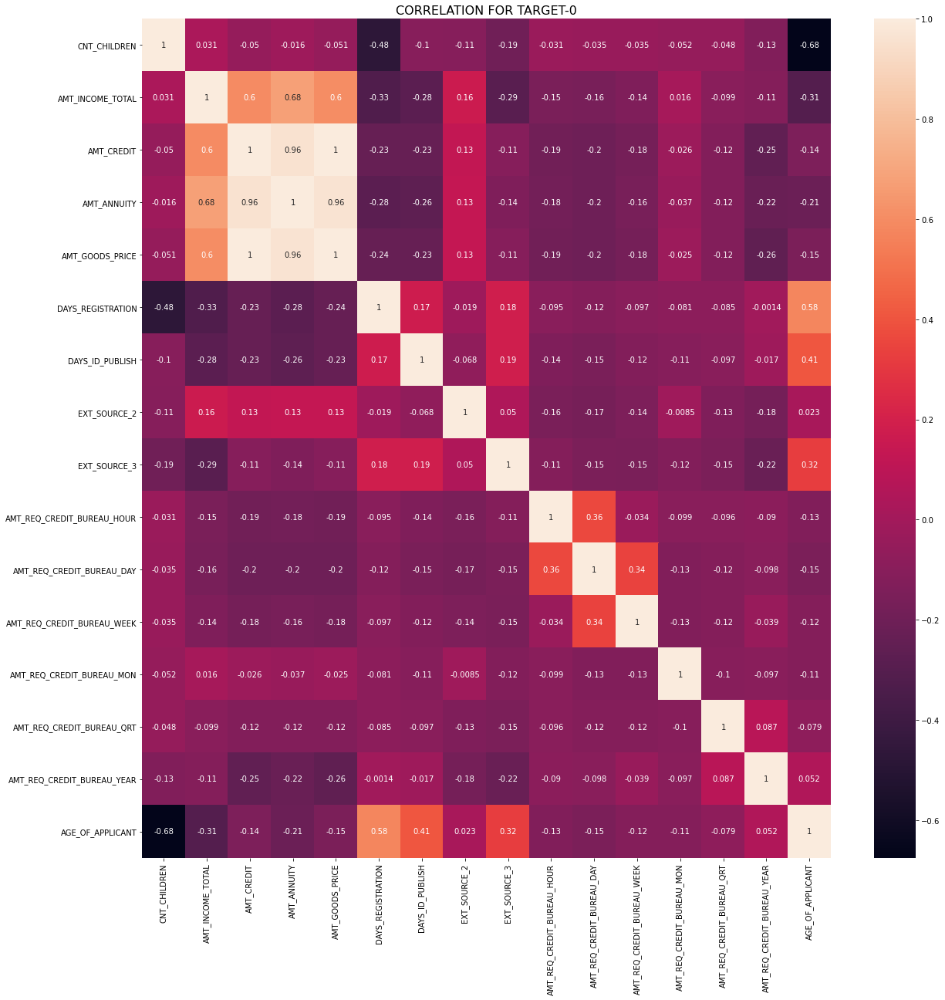

In [41]:
fig, ax = plt.subplots(figsize=(20,20))
plt.title("CORRELATION FOR TARGET-0",fontsize=16)
sns.heatmap(corr_0.corr(),annot=True)
plt.show()

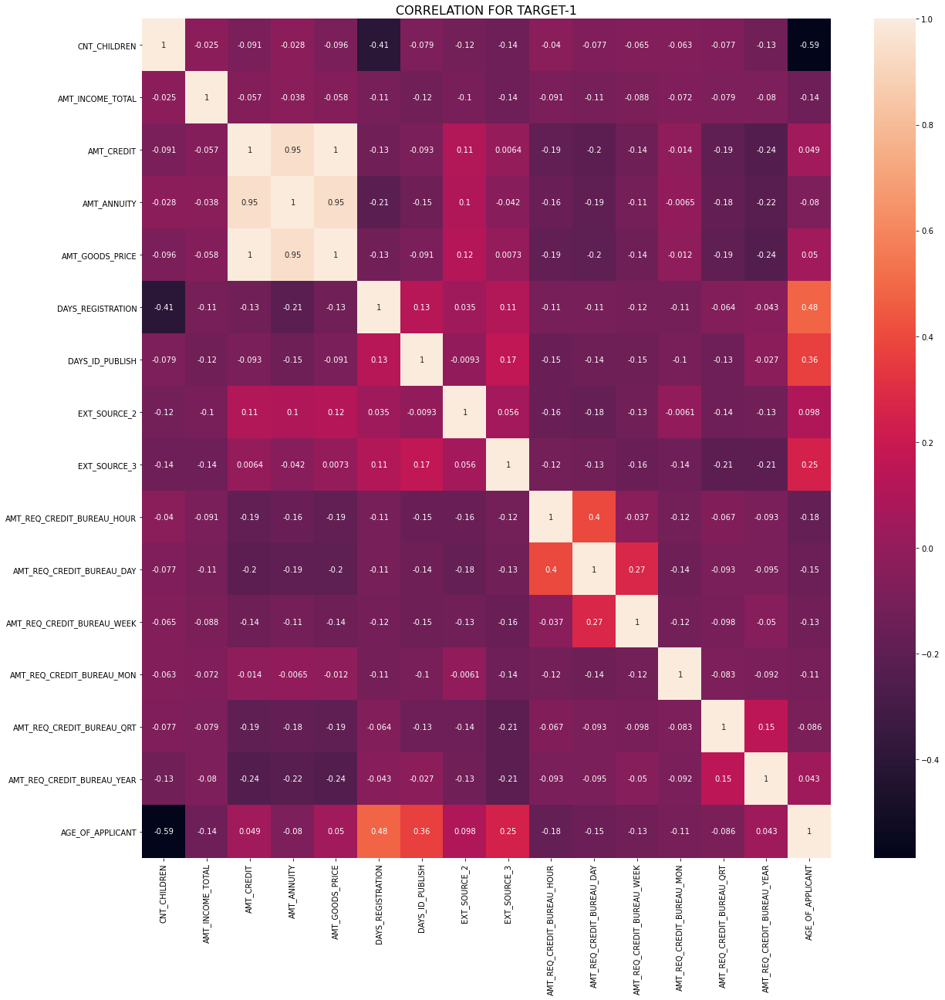

In [42]:
fig, ax = plt.subplots(figsize=(20,20))
plt.title("CORRELATION FOR TARGET-1",fontsize=16)
sns.heatmap(corr_1.corr(),annot=True)
plt.show()

### Top 10 correlations for TARGET columns

In [43]:
# Finding the best correlated variables using triu function

corr_0_df=corr_0.where(np.triu(np.ones(corr_0.shape),k=1).astype(bool))
corr_0_df=corr_0_df.unstack().reset_index().dropna(subset=[0])
corr_0_df.columns=['Column Variable 1','Column Variable 2','Correlation Value']
corr_0_df['Correlation Absolute']= abs(corr_0_df['Correlation Value'])
corr_0_df.sort_values(by='Correlation Absolute',ascending=False,inplace=True)
corr_0_df.iloc[0:11,:]

,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
66,AMT_GOODS_PRICE,AMT_CREDIT,0.987250,0.987250
67,AMT_GOODS_PRICE,AMT_ANNUITY,0.776686,0.776686
50,AMT_ANNUITY,AMT_CREDIT,0.771309,0.771309
49,AMT_ANNUITY,AMT_INCOME_TOTAL,0.418953,0.418953
65,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,0.349462,0.349462
33,AMT_CREDIT,AMT_INCOME_TOTAL,0.342799,0.342799
240,AGE_OF_APPLICANT,CNT_CHILDREN,-0.336907,0.336907
245,AGE_OF_APPLICANT,DAYS_REGISTRATION,0.333025,0.333025
246,AGE_OF_APPLICANT,DAYS_ID_PUBLISH,0.270804,0.270804
169,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,0.229065,0.229065


In [44]:
# Sorting and showing the values based on Correlation value

corr_0_df.sort_values(by='Correlation Value',ascending=True,inplace=True)
corr_0_df.iloc[0:15,:]

,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
240,AGE_OF_APPLICANT,CNT_CHILDREN,-0.336907,0.336907
80,DAYS_REGISTRATION,CNT_CHILDREN,-0.185792,0.185792
129,EXT_SOURCE_3,AMT_INCOME_TOTAL,-0.072401,0.072401
232,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE_3,-0.070355,0.070355
81,DAYS_REGISTRATION,AMT_INCOME_TOTAL,-0.064937,0.064937
241,AGE_OF_APPLICANT,AMT_INCOME_TOTAL,-0.062494,0.062494
228,AMT_REQ_CREDIT_BUREAU_YEAR,AMT_GOODS_PRICE,-0.051266,0.051266
226,AMT_REQ_CREDIT_BUREAU_YEAR,AMT_CREDIT,-0.048866,0.048866
224,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,-0.042547,0.042547
128,EXT_SOURCE_3,CNT_CHILDREN,-0.041729,0.041729


In [45]:
# Finding the best correlated variables using triu function

corr_1_df=corr_1.where(np.triu(np.ones(corr_1.shape),k=1).astype(bool))
corr_1_df=corr_1_df.unstack().reset_index().dropna(subset=[0])
corr_1_df.columns=['Column Variable 1','Column Variable 2','Correlation Value']
corr_1_df['Correlation Absolute']= abs(corr_1_df['Correlation Value'])
corr_1_df.sort_values(by='Correlation Absolute',ascending=False,inplace=True)
corr_1_df.iloc[0:11,:]

,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
66,AMT_GOODS_PRICE,AMT_CREDIT,0.983103,0.983103
67,AMT_GOODS_PRICE,AMT_ANNUITY,0.752699,0.752699
50,AMT_ANNUITY,AMT_CREDIT,0.752195,0.752195
245,AGE_OF_APPLICANT,DAYS_REGISTRATION,0.289116,0.289116
240,AGE_OF_APPLICANT,CNT_CHILDREN,-0.259222,0.259222
246,AGE_OF_APPLICANT,DAYS_ID_PUBLISH,0.252256,0.252256
169,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,0.246741,0.246741
186,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_DAY,0.184098,0.184098
248,AGE_OF_APPLICANT,EXT_SOURCE_3,0.171501,0.171501
80,DAYS_REGISTRATION,CNT_CHILDREN,-0.149154,0.149154


In [46]:
# Sorting and showing the values based on Correlation value

corr_1_df.sort_values(by='Correlation Value',ascending=True,inplace=True)
corr_1_df.iloc[0:30,:]

,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
240,AGE_OF_APPLICANT,CNT_CHILDREN,-0.259222,0.259222
80,DAYS_REGISTRATION,CNT_CHILDREN,-0.149154,0.149154
232,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE_3,-0.052539,0.052539
216,AMT_REQ_CREDIT_BUREAU_QRT,EXT_SOURCE_3,-0.048683,0.048683
228,AMT_REQ_CREDIT_BUREAU_YEAR,AMT_GOODS_PRICE,-0.037848,0.037848
226,AMT_REQ_CREDIT_BUREAU_YEAR,AMT_CREDIT,-0.035719,0.035719
224,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,-0.035427,0.035427
83,DAYS_REGISTRATION,AMT_ANNUITY,-0.034279,0.034279
184,AMT_REQ_CREDIT_BUREAU_WEEK,EXT_SOURCE_3,-0.020563,0.020563
128,EXT_SOURCE_3,CNT_CHILDREN,-0.020268,0.020268


#### Insights on Correlation:

##### In both cases (for target  1 and 0),
- We could see highly positive correaltion between AMT_CREDIT, AMT_ANNUITY and AMT_GOODS_PRICE 
- We can see that AGE_OF_APPLICANT and AMT_INCOME_TOTAL, DAYS_REGISTRATION and AMT_INCOME_TOTAL, EXT_SOURCE3 and AMT_INCOME_TOTAL are Negatively correlated

<a id="16"></a>
### UNI-VARIATE CONTINUOUS:

In [47]:
# Defining the function for plotting distplot 

def unidistplot(data1,data2,col,title,label):
    
    fig, (ax1, ax2) = plt.subplots(ncols=2,figsize=(15,8))
    fig.suptitle(title.upper(),weight='bold',fontsize=20)
    sns.distplot(data1[col].dropna(),kde=True,bins=30,ax = ax1)
    ax1.set_title('For Target 0'.upper())
    ax1.set_xlabel(label.upper())
    
    sns.distplot(data2[col].dropna(),kde=True,bins=30,ax = ax2)
    ax2.set_title('For Target 1'.upper())
    ax2.set_xlabel(label.upper())
    for ax in fig.axes:
        plt.sca(ax)
        plt.xticks(rotation=45)
    plt.tight_layout()
#     plt.savefig(col)
    plt.show()
    

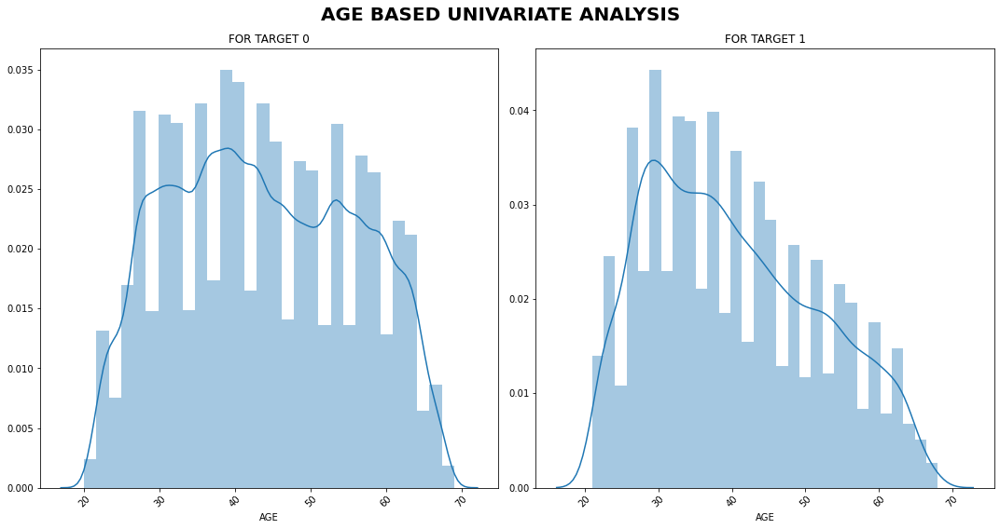

In [48]:
# Plotting the chart using function

unidistplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='AGE_OF_APPLICANT',title='Age based univariate Analysis',label='Age')

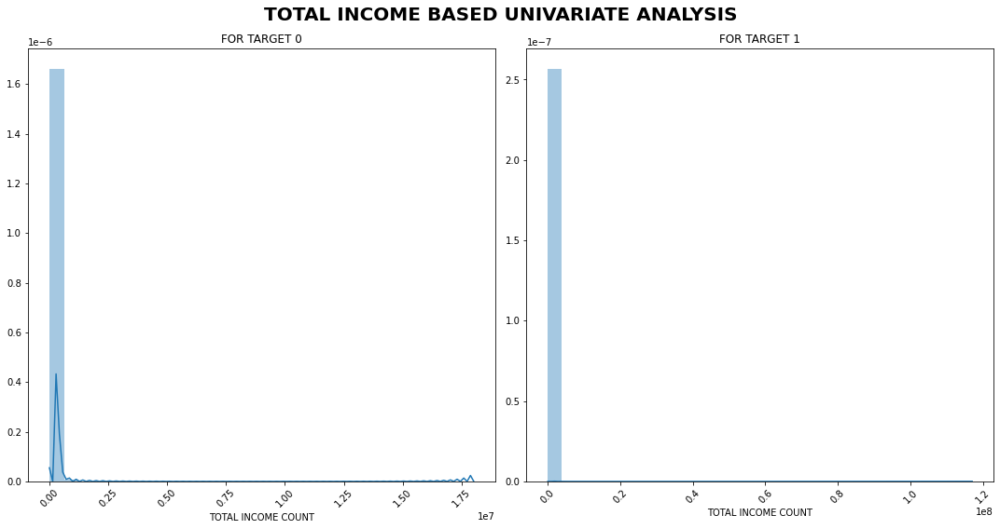

In [49]:
# Plotting the chart using function

unidistplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='AMT_INCOME_TOTAL',title='Total Income based univariate Analysis',label='Total Income count')

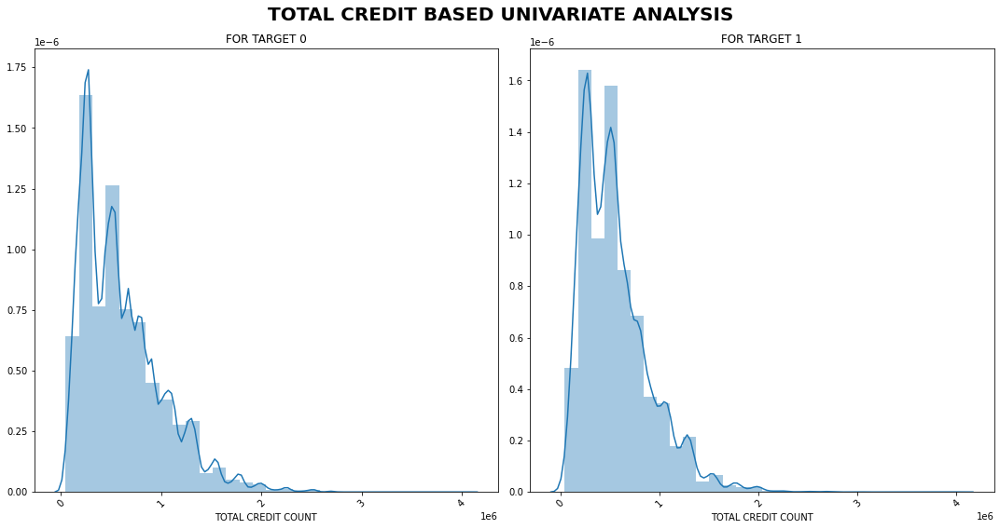

In [50]:
# Plotting the chart using function

unidistplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='AMT_CREDIT',title='Total credit based univariate Analysis',label='Total credit count')

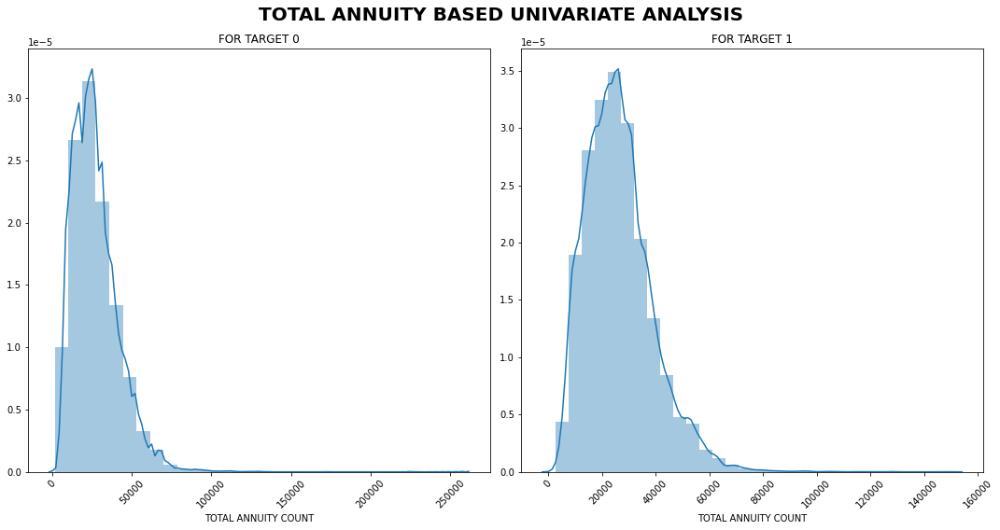

In [51]:
# Plotting the chart using function

unidistplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='AMT_ANNUITY',title='Total Annuity based univariate Analysis',label='Total Annuity count')

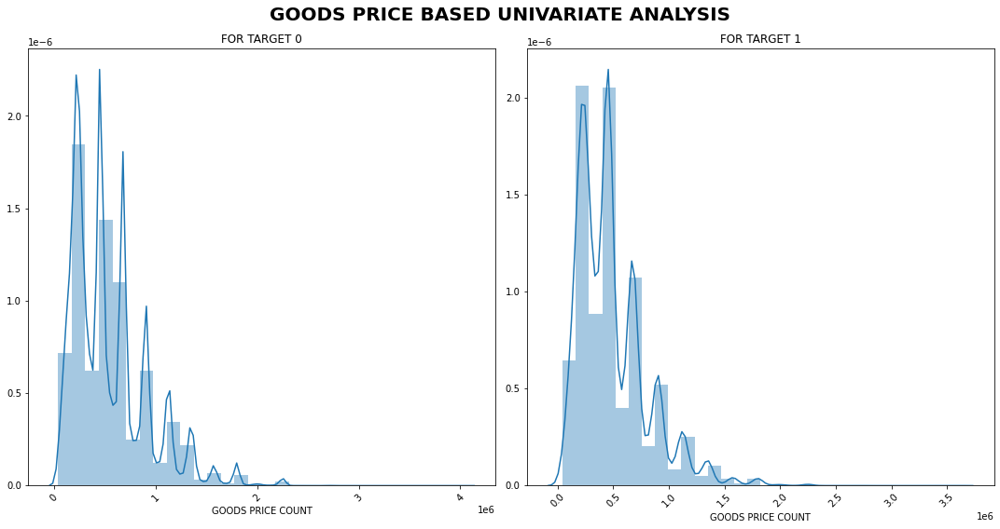

In [52]:
# Plotting the chart using function

unidistplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,col='AMT_GOODS_PRICE',title='Goods Price based univariate Analysis',label='Goods Price count')

***Insights from the above plot:***
1. From the plot we could see that the most number of loans are availed by persons who are in the Age between 30 and 45 in both Target 0 and 1.
2. Persons who are in the Age group between 25 and 30 has the high default rate.
3. Most common/frequent loan amount given by finance company is  in the range between 200K and 600K in both Target 0 and 1.
4. Also highest number of persons are having payment difficulties falls in the 200k and 600K loan amount. 
5. Most common/frequent Annuity amount is in the range between 25K and 45K in both Target 0 and 1.
6. Also highest number of persons are having payment difficulties falls in the 25k and 35K Annuity amount.
7. Highest/most frequently Consumer loans are provided when the Goods price falls in the range between 200k and 500K
8. Also highest number of persons are having payment difficulties for the GOODS Price falls in the 200K and 500K.

<a id="18"></a>
## BI - VARIATE ANALYSIS:

<a id="19"></a>
### CONTINUOUS - CATEGORICAL:

Defining a function below to show the Bi - variate and its relations

In [53]:
# Creating a function with necessary parameters,setting up styles and axes.

def bivariateplot(data1,data2,colx,coly,hue,title,xlabel,ylabel,legend):
    fig ,axes=plt.subplots(1,2,figsize=(20,10),sharex = True,sharey=True)
    sns.set_style('whitegrid')
    sns.set_context('talk')
    sns.axes_style('dark')
#     sns. despine(left = True)
    
    ax1=sns.boxplot(data =data1, x=colx,y=coly, hue =hue,orient='h',ax=axes[0],palette='cool')
    ax1.set_title(title.upper()+" - Target 0".upper(),weight='bold',fontsize=20)
    ax1.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax1.set_ylabel(ylabel.upper(),fontsize=16,weight='bold')
    ax1.set_yticklabels(ax1.get_yticklabels(),rotation=60,fontsize=14)
    ax1.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax1.set_xscale('log')
    ax1.tick_params(labelsize=14)
    
    ax2=sns.boxplot(data =data2, x=colx,y=coly, hue =hue,orient='h',ax=axes[1],palette='cool')
    ax2.set_title(title.upper()+" - Target 1".upper(),weight='bold',fontsize=20)
    ax2.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax2.set_ylabel(''.upper(),fontsize=16,weight='bold')
    ax2.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax2.set_xscale('log')
    ax2.tick_params(labelsize=14)
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

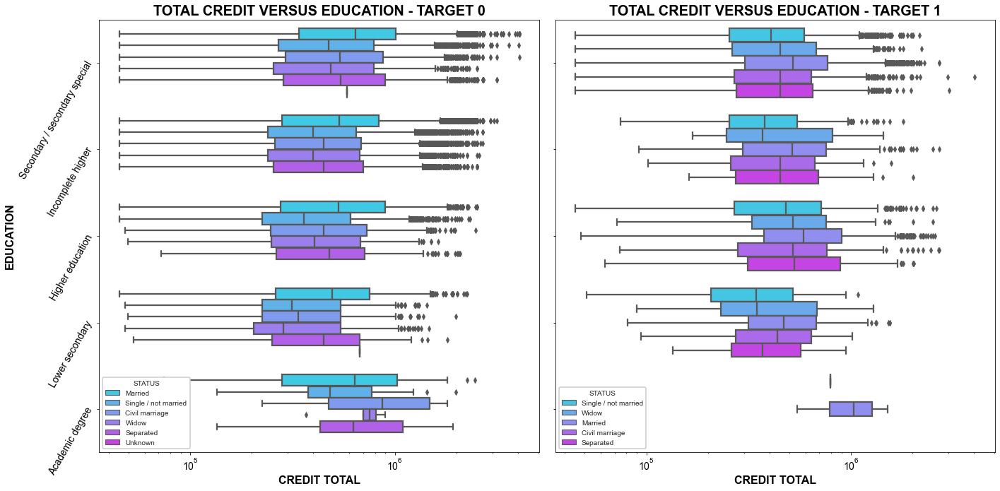

In [54]:
# Passing parameters of AMT_CREDIT and NAME_EDUCATION_TYPE to see the insights for Target 0

bivariateplot(CLIENT_WITH_OTHER_CASES_pre,CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx='AMT_CREDIT',coly='NAME_EDUCATION_TYPE',hue='NAME_FAMILY_STATUS',xlabel='Credit Total',ylabel='Education',title='total Credit versus Education',legend='Status')

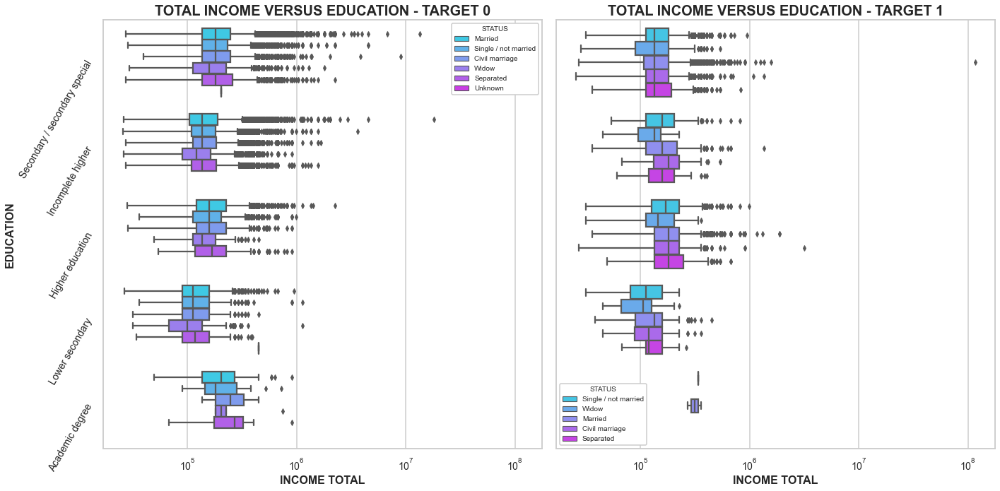

In [55]:
# Passing parameters of AMT_INCOME_TOTAL and NAME_EDUCATION_TYPE to see the insights for Target 0

bivariateplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx='AMT_INCOME_TOTAL',coly='NAME_EDUCATION_TYPE',hue='NAME_FAMILY_STATUS',xlabel='income total',ylabel='education',title='total income versus Education',legend='status')

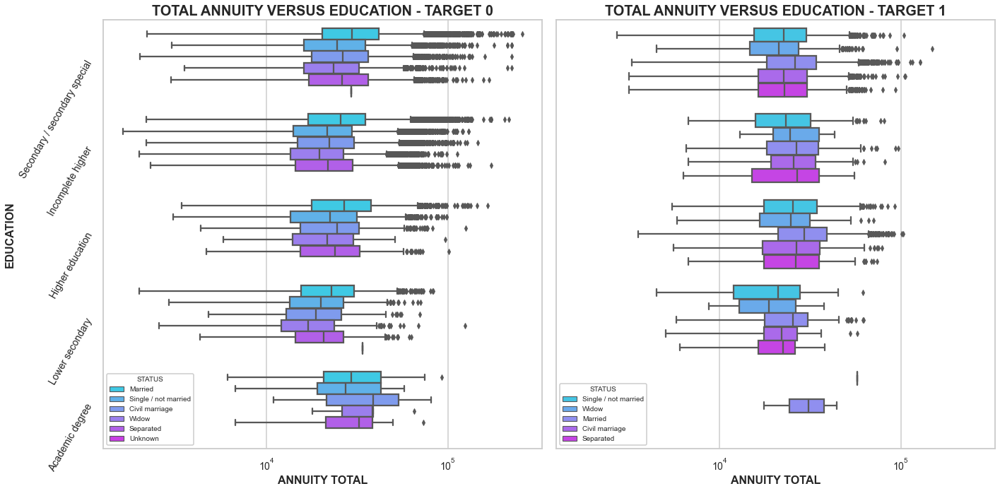

In [56]:
# Passing parameters of AMT_INCOME_TOTAL and NAME_EDUCATION_TYPE to see the insights for Target 0 

bivariateplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx='AMT_ANNUITY',coly='NAME_EDUCATION_TYPE',hue='NAME_FAMILY_STATUS',xlabel='Annuity total',ylabel='education',title='total annuity versus Education',legend='status')

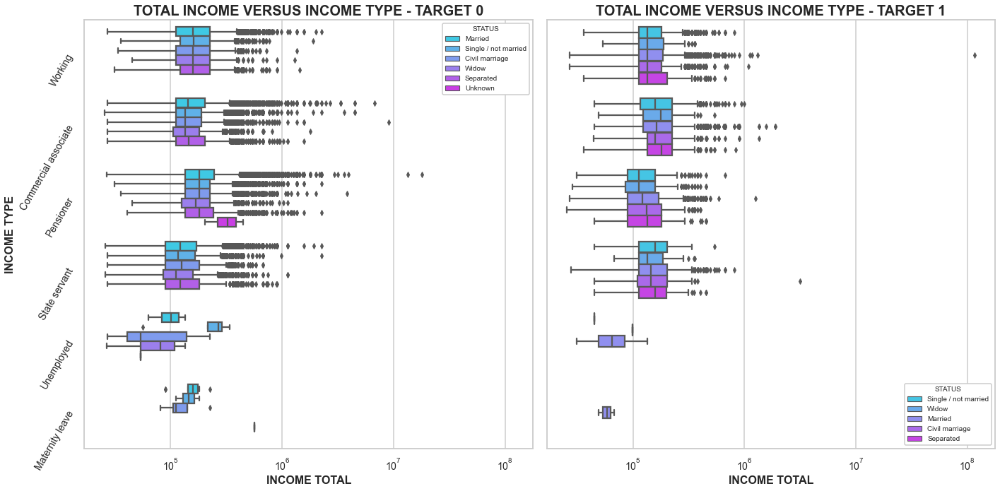

In [57]:
# Plotting the chart using function

bivariateplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx='AMT_INCOME_TOTAL',coly='NAME_INCOME_TYPE',hue='NAME_FAMILY_STATUS',xlabel='income total',ylabel='income type',title='total income versus income type',legend='status')

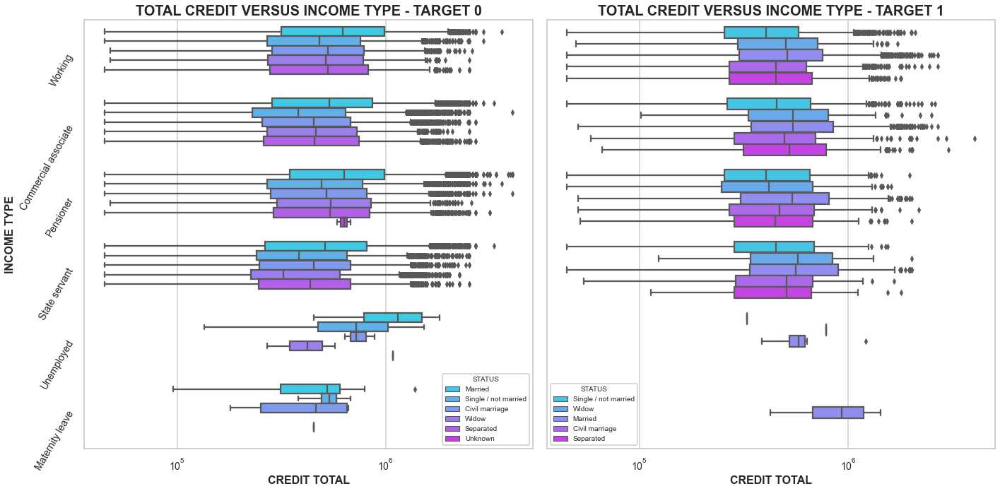

In [58]:
# Plotting the chart using function

bivariateplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx='AMT_CREDIT',coly='NAME_INCOME_TYPE',hue='NAME_FAMILY_STATUS',xlabel='credit total',ylabel='income type',title='total credit versus income type',legend='status')

### Insights for BiVariate Continuous – Categorical:
Following variables are considered:
1.	AMT_CREDIT, FAMILY_STATUS and Education:
    a. We can see that the Credit amount is more for persons who are Married and having completed Secondary Education and Higher Education.
    b. Payment with difficulties also higher in Married persons who has completed Secondary Education and Higher Education.
2.	INCOME, FAMILY_STATUS and Education:
    a. We can see that the Income is more for persons who are Married and having completed Secondary Education and Higher Education.
3.	AMT_ANNUITY, FAMILY_STATUS and Education:
    a. We can see that the Annuity amount is more for persons who are Married and having completed Secondary Education and Higher Education.
    b. We can see that when the income is higher then the Annuity amount also higher.
4.	AMT_INCOME, Income_type and FAMILY_STATUS:
    a. Most Number of loans are given to Married/Single people employed in 'Working' categories followed by 'Commercial associates' and 'State servant'. 
    b. Pensioner also higher number of loans however they are better in repaying the loan when compared to 'Working' categories followed by 'Commercial associates'
    c. Loans are not sanctioned or very less number sanctioned for 'UnEmployed', 'Maternity Leave' category.
    d. We can see that the Loans default rate is high in Single/Widow people employed in 'Working' categories followed by 'Commercial associate'.
5.	AMT_CREDIT, Income_type and FAMILY_STATUS:
    a. Credit amount is higher for Married/Single people employed in 'Working' categories followed by 'Commercial associates' and 'State servant'. 
    b. Pensioner and State Servant also has moderate number of loans however they are better in repaying the loan when compared to 'Working' categories followed by 'Commercial associates'.
    c. Loans are not sanctioned or very less number sanctioned for 'UnEmployed', 'Maternity Leave' category.
    d. We can see that the Loans default rate is high in Single/Widow people employed in 'Working' categories followed by 'Commercial associate'.

### BI-VARIATE CONTINUOUS - CONTINUOUS:

In [59]:
# Defining the function to plot scatterplot

def biscatterplot(data1,data2,colx,coly,hue,title,xlabel,ylabel,legend):
    fig ,axes=plt.subplots(1,2,figsize=(20,10),sharex = True,sharey=True)
    sns.set_style('whitegrid')
    sns.set_context('talk')
    sns.axes_style('dark')
    
    ax1=sns.scatterplot(data =data1, x=colx,y=coly, hue =hue,ax=axes[0],palette='mako')
    ax1.set_title(title.upper()+" - Target 0".upper(),weight='bold',fontsize=20)
    ax1.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax1.set_ylabel(ylabel.upper(),fontsize=16,weight='bold')
    ax1.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax1.set_xscale('log')
    ax1.set_yscale('log')
    ax1.tick_params(labelsize=14)
    
    ax2=sns.scatterplot(data =data2, x=colx,y=coly, hue =hue,ax=axes[1],palette='cool')
    ax2.set_title(title.upper()+" - Target 1".upper(),weight='bold',fontsize=20)
    ax2.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax2.set_ylabel(''.upper(),fontsize=16,weight='bold')
    ax2.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax2.set_xscale('log')
    ax2.set_yscale('log')
    ax2.tick_params(labelsize=14)
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

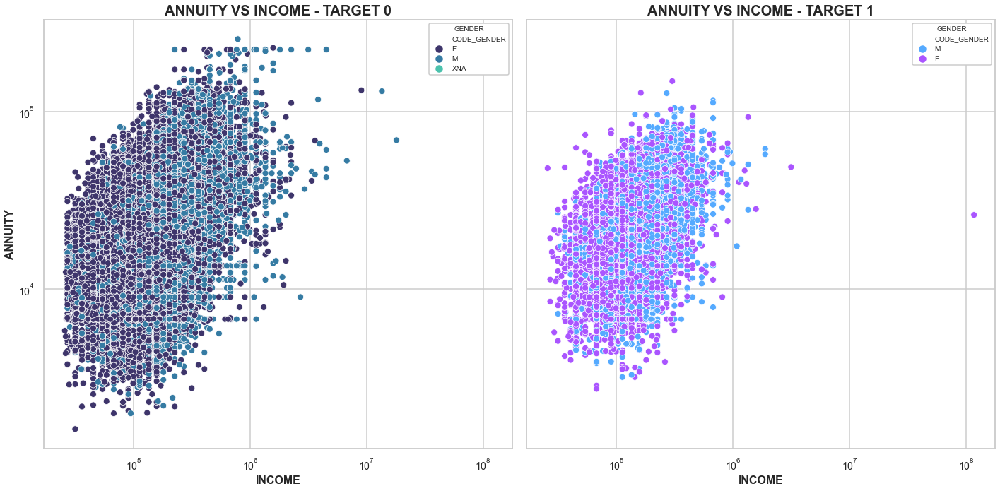

In [60]:
# Plotting the chart using function

biscatterplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="AMT_INCOME_TOTAL",coly="AMT_ANNUITY",hue="CODE_GENDER",xlabel='income',ylabel="annuity",title="Annuity vs income",legend='gender')

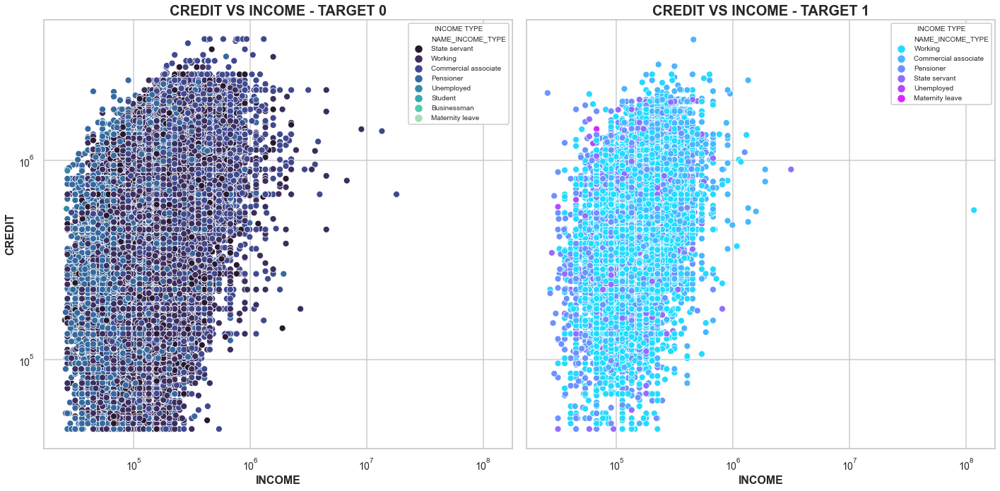

In [61]:
# Plotting the chart using function

biscatterplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="AMT_INCOME_TOTAL",coly="AMT_CREDIT",hue="NAME_INCOME_TYPE",xlabel='income',ylabel="credit",title="credit vs income",legend='income type')

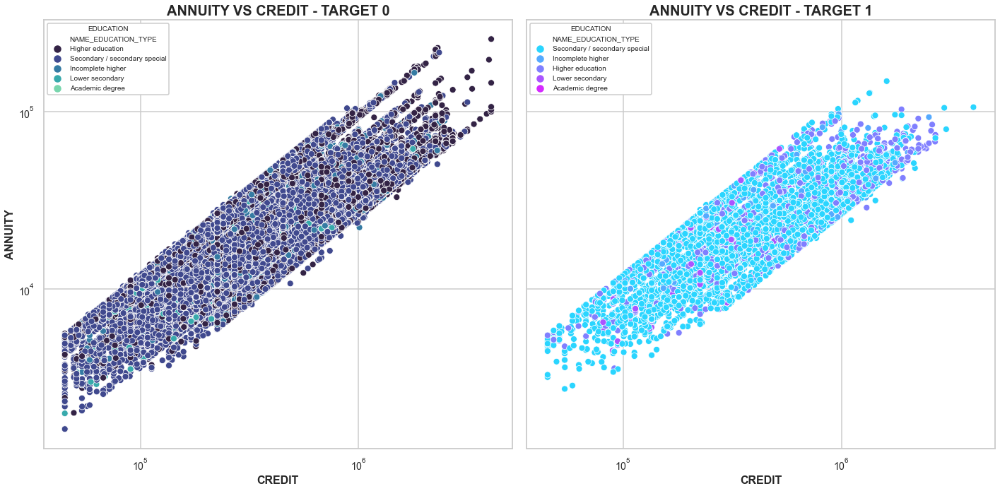

In [62]:
# Plotting the chart using function

biscatterplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="AMT_CREDIT",coly="AMT_ANNUITY",hue="NAME_EDUCATION_TYPE",xlabel='credit',ylabel="annuity",title="Annuity vs credit",legend='education')

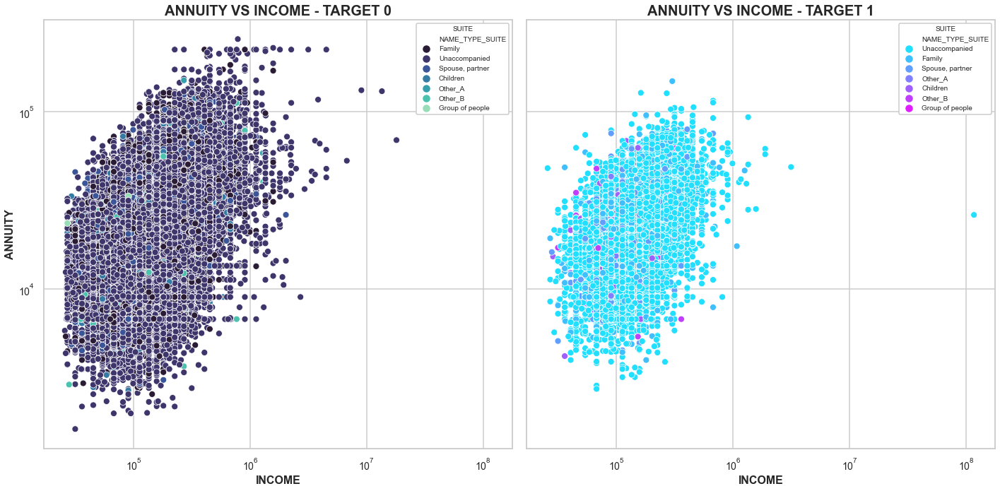

In [63]:
# Plotting the chart using function

biscatterplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="AMT_INCOME_TOTAL",coly="AMT_ANNUITY",hue="NAME_TYPE_SUITE",xlabel='income',ylabel="annuity",title="Annuity vs income",legend='suite')

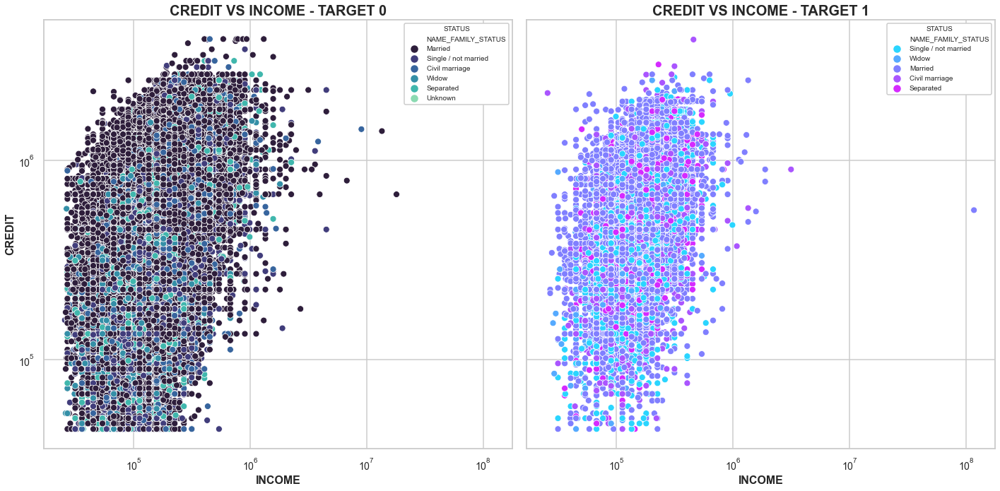

In [64]:
# Plotting the chart using function

biscatterplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="AMT_INCOME_TOTAL",coly="AMT_CREDIT",hue="NAME_FAMILY_STATUS",xlabel='income',ylabel="credit",title="credit vs income",legend='status')

 ### Insights for BiVariate Continuous – Continuous:
Following variables are considered:

Annuity Vs Income based on Gender & Annuity vs Income based on Family Status:

    1. We can see that there is a huge cluster in the income range 100K – 1000K.
	2. Also we could see that when the income increases then Annuity amount also increased. Huge cluster in the Annuity amount present in 10K – 100k
	3. Loan default rate is high for the persons whose income range 100K – 1000K
	
Credit Vs Income based on Income Type & Credit vs Income based on Family Status:

    1. We can see that there is a huge cluster in the income range 100K – 1000K.
    2. We could see that when the income/Salary is higher, then the Loan/Credit amount also increased. Huge cluster in the Credit amount present in 100K – 1000k
    3. Loan default rate is high for the persons whose Income range 100K – 1000K.

Annuity vs Credit:

    1.We can see that there is a huge cluster in the Credit range 100K – 1000K.
    2.We could see that when the Loan Amount is higher, then Annuity amount also increased. Huge cluster in the Annuity amount present in 10K – 100k
    3.Loan default rate is high for the persons whose Credit range 100K – 1000K

### BI-VARIATE CATEGORICAL - CATEGORICAL:

In [65]:
# Defining the function to plot countplot 

def bicountplot(data1,data2,colx,hue,title,xlabel,legend):
    fig ,axes=plt.subplots(1,2,figsize=(20,10),sharex = True,sharey=True)
    sns.set_style('whitegrid')
    sns.set_context('talk')
    sns.axes_style('dark')
    
    ax1=sns.countplot(data =data1, x=colx, hue =hue,ax=axes[0],palette='mako')
    ax1.set_title(title.upper()+" - Target 0".upper(),weight='bold',fontsize=20)
    ax1.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax1.set_ylabel('count'.upper(),fontsize=16,weight='bold')
    ax1.set_xticklabels(ax1.get_xticklabels(),rotation=60,fontsize=14)
    ax1.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax1.set_yscale('log')
    ax1.tick_params(labelsize=14)
    
    ax2=sns.countplot(data =data2, x=colx, hue =hue,ax=axes[1],palette='cool')
    ax2.set_title(title.upper()+" - Target 1".upper(),weight='bold',fontsize=20)
    ax2.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax2.set_ylabel(''.upper(),fontsize=16,weight='bold')
    ax2.set_xticklabels(ax2.get_xticklabels(),rotation=60,fontsize=14)
    ax2.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax2.set_yscale('log')
    ax2.tick_params(labelsize=14)
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

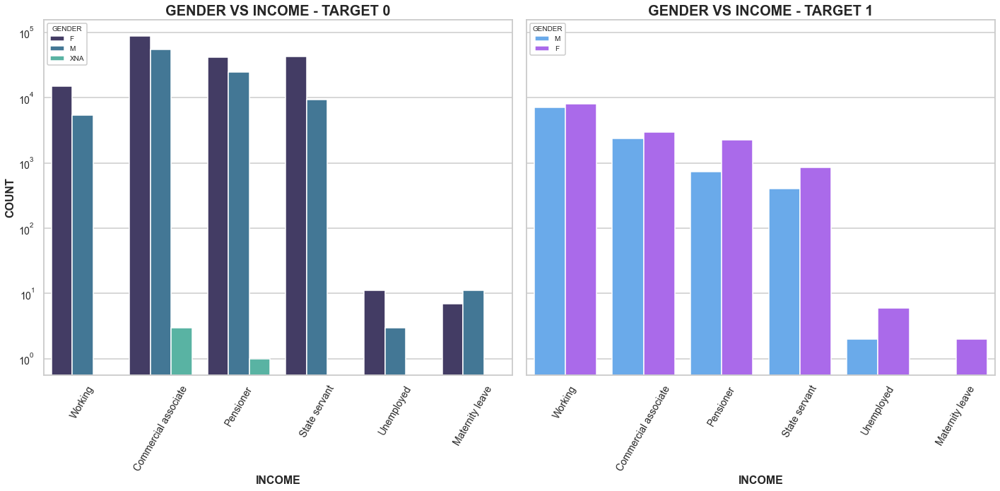

In [66]:
# Plotting the chart using function

bicountplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="NAME_INCOME_TYPE",hue="CODE_GENDER",xlabel='income',title="gender vs income",legend='gender')

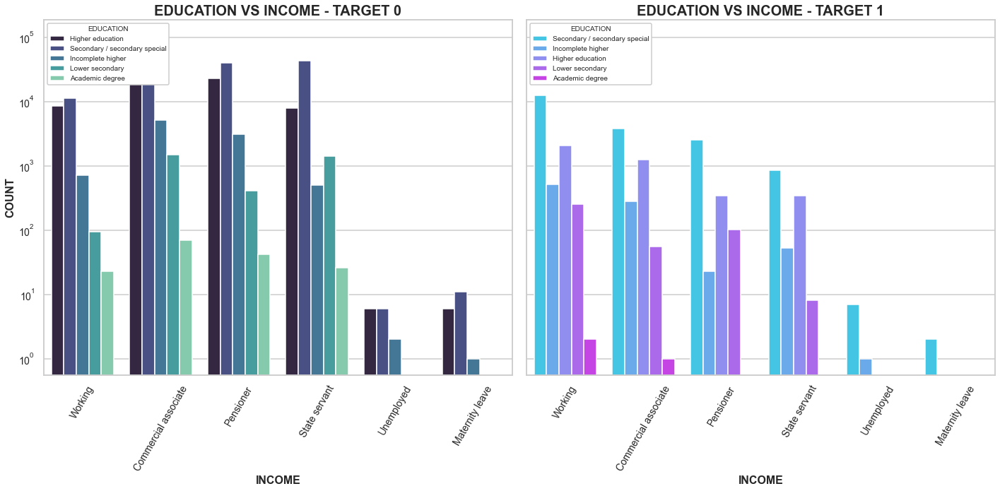

In [67]:
# Plotting the chart using function

bicountplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="NAME_INCOME_TYPE",hue="NAME_EDUCATION_TYPE",xlabel='income',title="education vs income",legend='education')

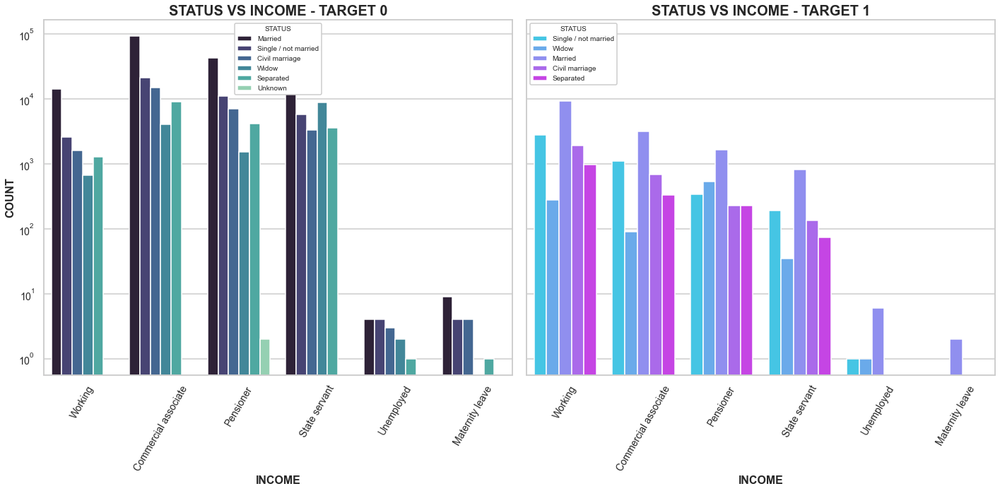

In [68]:
# Plotting the chart using function

bicountplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="NAME_INCOME_TYPE",hue="NAME_FAMILY_STATUS",xlabel='income',title="status vs income",legend='status')

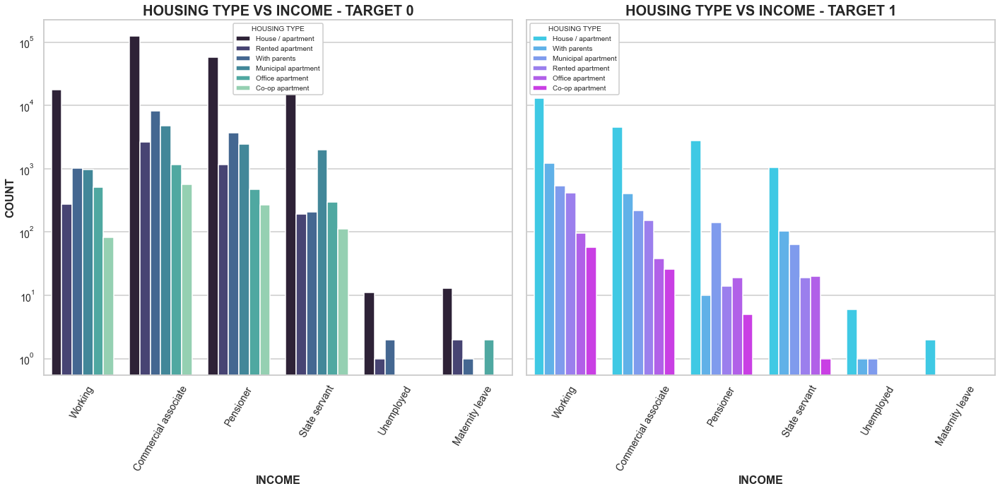

In [69]:
# Plotting the chart using function

bicountplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="NAME_INCOME_TYPE",hue="NAME_HOUSING_TYPE",xlabel='income',title="Housing type vs income",legend='Housing type')

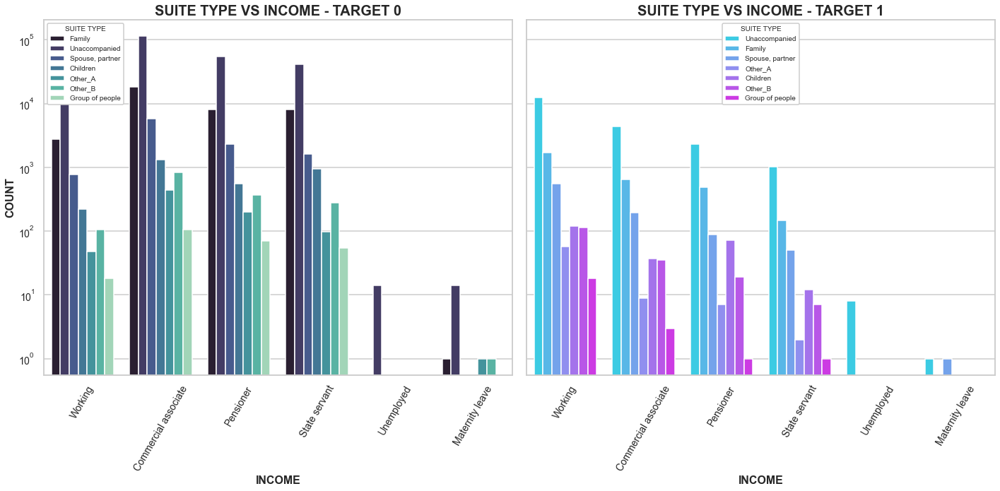

In [70]:
# Plotting the chart using function

bicountplot(data1=CLIENT_WITH_OTHER_CASES_pre,data2=CLIENT_WITH_PAYMENT_DIFFICULTIES_pre,colx="NAME_INCOME_TYPE",hue="NAME_TYPE_SUITE",xlabel='income',title="suite type vs income",legend='suite type')

### Insights for Bivariate Categorical - Categorical:

#### Gender: 

     Payment difficulties rate is marginally high with Gender ‘M’. Payment difficulties of rate of 'F' is at 7% where 'M' is at 10%. Gender ‘M’ Earn more than ‘F’.
    1.High Number of loans are given to Female who are 'Working’, followed by 'Commercial associates' and ‘Pensioner’.
    2.Loan Default rate ratio is higher in Male who are ‘Working’, 'Commercial associates' and 'State servant’ when compared to Female.
    3.Less number of Loans sanctioned for 'UnEmployed' and 'Maternity Leave' Category.
    
#### Education Type:
    1. Most Number of loans are given for client/customer who has completed Secondary Education and it is followed by client who has completed Higher Education.
    2. More number of Clients who has Payment difficulties are in Secondary Education category. Clients with Higher Education degree has better chances of Loan Payment when compared to Secondary Education Client.
#### Income Type: 
    Most Number of loans are given to 'Working' categories followed by 'Commercial associates' and 'State servant’.
#### Family Status:
     Married people have more difficulties in payments. And the spread of Credit amount is more compare to other categories.
#### Housing Type:
    1. Most Number of loans are availed by people who are living in 'House/Apartment' and 'Rented Apartment'
    2. Loan default rate is high among people who are living in 'House/Apartment' and 'Parents'. Interestingly, People living in 'Rented Apartment' has slightly better Loan repayment when to 'House/Apartment'.

#### Suite Type:
    1. Most number of loans are given to person who are 'Unaccompanied','Family' and 'Spouse/Partner'
    2. Loan default rate is high for 'Unaccompanied','Family' and 'Spouse/Partner' who are having income under 'Working' and 'Commercial Associate" when compared to other Income Type categories.

<a id="19"></a>
## PREVIOUS APPLICATION EXPLORATORY



In [71]:
# Reading the CSV file named 'previous_application' as previous_application DataFrame

previous_application = pd.read_csv('previous_application.csv')
pd.set_option('display.max_columns', 500) 
previous_application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


### DATA SHAPE:
Based on the above info, we could identify that the column name ***SK_ID_CURR*** acts as a common column among the datasets


In [72]:
previous_application.shape

(1670214, 37)

### Missing Value:

Finding how many columns are having more than 50% of the NaN values and removing it from the dataset

In [73]:
# Finding the null value columns

emptycolumn_finder_1=previous_application.isnull().sum()
emptycolumn_1 = emptycolumn_finder_1[(emptycolumn_finder_1.values>=0.5*len(previous_application))]
emptycolumn_1

AMT_DOWN_PAYMENT             895844
RATE_DOWN_PAYMENT            895844
RATE_INTEREST_PRIMARY       1664263
RATE_INTEREST_PRIVILEGED    1664263
dtype: int64

It is understood that totally 4 columns are to be removed

In [74]:
# Dropping the above gathered columns from the DF
previous_application.drop(labels=emptycolumn_1.index,axis=1,inplace=True)

After dropping the columns from the DF, the shape of the DF would be 

In [75]:
previous_application.shape

(1670214, 33)

## MERGING THE DATASET:

In [76]:
# Joining the two dataframes using  the 'SK_ID_CURR'

final_application=pd.merge(left=current_application,right=previous_application,how='inner',on='SK_ID_CURR',suffixes='_x')

In [77]:
# Having a glimpse of data in the final dataframe

final_application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_,AMT_ANNUITY_,AMT_GOODS_PRICE_,NAME_TYPE_SUITE_,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START_,HOUR_APPR_PROCESS_START_,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE_OF_APPLICANT,INCOME_RANGE,CREDIT_RANGE,SK_ID_PREV,NAME_CONTRACT_TYPEx,AMT_ANNUITYx,AMT_APPLICATION,AMT_CREDITx,AMT_GOODS_PRICEx,WEEKDAY_APPR_PROCESS_STARTx,HOUR_APPR_PROCESS_STARTx,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITEx,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648,2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,25,200000-300000,200000-300000,1038818,Consumer loans,9251.775,179055.0,179055.0,179055.0,SATURDAY,9,Y,1,XAP,Approved,-606,XNA,XAP,NaN,New,Vehicles,POS,XNA,Stone,500,Auto technology,24.0,low_normal,POS other with interest,365243.0,-565.0,125.0,-25.0,-17.0,0.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,45,200000-300000,500000 and above,1810518,Cash loans,98356.995,900000.0,1035882.0,900000.0,FRIDAY,12,Y,1,XNA,Approved,-746,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,-716.0,-386.0,-536.0,-527.0,1.0
2,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,45,200000-300000,500000 and above,2636178,Consumer loans,64567.665,337500.0,348637.5,337500.0,SUNDAY,17,Y,1,XAP,Approved,-828,Cash through the bank,

<a id ="21"></a>
## IDENTIFYING THE DATA TYPES

In [78]:
# Showing the info od the DF

final_application.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1413701 entries, 0 to 1413700
Data columns (total 116 columns):
 #   Column                        Dtype   
---  ------                        -----   
 0   SK_ID_CURR                    int64   
 1   TARGET                        object  
 2   NAME_CONTRACT_TYPE_           object  
 3   CODE_GENDER                   object  
 4   FLAG_OWN_CAR                  object  
 5   FLAG_OWN_REALTY               object  
 6   CNT_CHILDREN                  int64   
 7   AMT_INCOME_TOTAL              float64 
 8   AMT_CREDIT_                   float64 
 9   AMT_ANNUITY_                  float64 
 10  AMT_GOODS_PRICE_              float64 
 11  NAME_TYPE_SUITE_              object  
 12  NAME_INCOME_TYPE              object  
 13  NAME_EDUCATION_TYPE           object  
 14  NAME_FAMILY_STATUS            object  
 15  NAME_HOUSING_TYPE             object  
 16  REGION_POPULATION_RELATIVE    float64 
 17  DAYS_BIRTH                    int64   
 18  D

<a id ="22"></a>
## SHAPE OF THE DATASET:

Once we joined the dataframes, the shape of the final dataframe will be

In [79]:
final_application.shape

(1413701, 116)

In [80]:
# Finding the column names created with suffices and renaming it to make more relevant
ind=final_application.columns[final_application.columns.str.match(r".*([x]|[_])$")]

for i in ind:
    if i[-1] == '_':
        final_application.rename({i:i[:-1]},axis=1,inplace=True)
    elif i[-1]=='x':
        final_application.rename({i:i[:-1]+'_PREV'},axis=1,inplace=True)

In [81]:
# Checking the column names after renaming
final_application.loc[:-1]

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE_OF_APPLICANT,INCOME_RANGE,CREDIT_RANGE,SK_ID_PREV,NAME_CONTRACT_TYPE_PREV,AMT_ANNUITY_PREV,AMT_APPLICATION,AMT_CREDIT_PREV,AMT_GOODS_PRICE_PREV,WEEKDAY_APPR_PROCESS_START_PREV,HOUR_APPR_PROCESS_START_PREV,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE_PREV,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL


### After renaming the shape would be

In [82]:
final_application.shape

(1413701, 116)

In [83]:
# Showing the info of the DF

final_application.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1413701 entries, 0 to 1413700
Columns: 116 entries, SK_ID_CURR to NFLAG_INSURED_ON_APPROVAL
dtypes: category(2), float64(37), int32(4), int64(36), object(37)
memory usage: 1.2+ GB


<a id ="23"></a>
## QUALITY OF THE DATASET

<a id ="24"></a>
### MISSING VALUE:

Columns which are having more than 50% NaN values removed, but which are less than 50% still exists. Lets take a look of that too. 

In [84]:
# Finding the missing values column of merged DF

emptycolumn_finder_1=final_application.isnull().sum()
emptycolumn_1 = emptycolumn_finder_1[(emptycolumn_finder_1.values>=0.5*len(final_application))]
len(emptycolumn_1)

0

Columns which are less than 13% exists. Lets take a look of that too. we are going to suggest for the columns which are having less than 13% null values columns 

In [85]:
# Printing the column with null values and percentage

emptycolumn_finder=final_application.isnull().sum()
emptycolumn = emptycolumn_finder[(emptycolumn_finder.values<=0.13*len(final_application)) & (emptycolumn_finder.values>0.0*len(final_application))]
for i in range(len(emptycolumn)):
    print(emptycolumn.index[i],emptycolumn[i],final_application[emptycolumn.index[i]].dtypes)

AMT_ANNUITY 93 float64
AMT_GOODS_PRICE 1208 float64
NAME_TYPE_SUITE 3526 object
EXT_SOURCE_2 1821 float64
OBS_30_CNT_SOCIAL_CIRCLE 3146 float64
DEF_30_CNT_SOCIAL_CIRCLE 3146 float64
OBS_60_CNT_SOCIAL_CIRCLE 3146 float64
DEF_60_CNT_SOCIAL_CIRCLE 3146 float64
AMT_REQ_CREDIT_BUREAU_HOUR 163627 float64
AMT_REQ_CREDIT_BUREAU_DAY 163627 float64
AMT_REQ_CREDIT_BUREAU_WEEK 163627 float64
AMT_REQ_CREDIT_BUREAU_MON 163627 float64
AMT_REQ_CREDIT_BUREAU_QRT 163627 float64
AMT_REQ_CREDIT_BUREAU_YEAR 163627 float64
AMT_CREDIT_PREV 1 float64
PRODUCT_COMBINATION 313 object


### Suggestions for the above case:

1. We could see from the above that Final/Merged application do not have any columns in the dataset that have got NA or missing values greater than 50%.
2. We have got have got 16 columns that are lesser than 13% NA or Missing values.

In [86]:
# printing the values for recommendations

print("AMT_ANNUITY column has median as ",final_application.AMT_ANNUITY.median())
print("AMT_GOODS_PRICE  column has median as ",final_application.AMT_GOODS_PRICE.median())
print("NAME_TYPE_SUITE  column has mode as ",final_application.NAME_TYPE_SUITE.mode().values[0])
print("EXT_SOURCE_2 column has median as ",final_application.EXT_SOURCE_2.median())
print("PRODUCT_COMBINATION column has mode as ",final_application.PRODUCT_COMBINATION.mode().values[0])

AMT_ANNUITY column has median as  24925.5
AMT_GOODS_PRICE  column has median as  450000.0
NAME_TYPE_SUITE  column has mode as  Unaccompanied
EXT_SOURCE_2 column has median as  0.5627679142553595
PRODUCT_COMBINATION column has mode as  Cash


<a id="25"></a>
### DATATYPE CHECK:

In [87]:
# Changing the data type of some variables

final_application.NFLAG_INSURED_ON_APPROVAL = final_application.NFLAG_INSURED_ON_APPROVAL.astype(str)
final_application.NFLAG_LAST_APPL_IN_DAY = final_application.NFLAG_LAST_APPL_IN_DAY.astype(str)
final_application.NAME_TYPE_SUITE_PREV = final_application.NAME_TYPE_SUITE_PREV.astype(str)
final_application.DAYS_FIRST_DRAWING = pd.to_numeric(final_application.DAYS_FIRST_DRAWING,errors='ignore',downcast='integer')
final_application.DAYS_TERMINATION = pd.to_numeric(final_application.DAYS_TERMINATION,errors='ignore',downcast='integer')
final_application.DAYS_LAST_DUE = pd.to_numeric(final_application.DAYS_LAST_DUE,errors='ignore',downcast='integer')
final_application.DAYS_FIRST_DUE = pd.to_numeric(final_application.DAYS_FIRST_DUE,errors='ignore',downcast='integer')
final_application.DAYS_DECISION = pd.to_numeric(final_application.DAYS_DECISION,errors='ignore',downcast='integer')
final_application.DAYS_LAST_DUE_1ST_VERSION = pd.to_numeric(final_application.DAYS_LAST_DUE_1ST_VERSION,errors='ignore',downcast='integer')
final_application.CNT_PAYMENT =pd.to_numeric(final_application.CNT_PAYMENT,errors='ignore',downcast='integer')

<a id="26"></a>
### OUTLIER DETECTION:

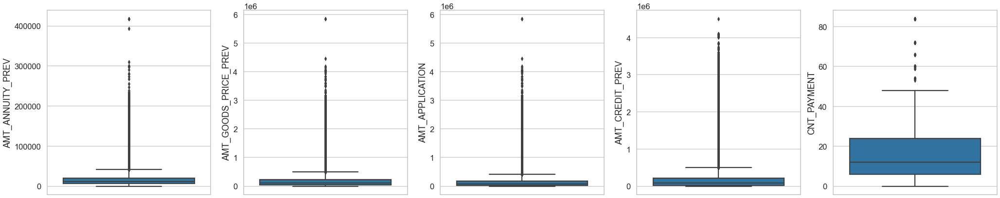

In [88]:
# Plotting the outlier using boxplot

fig,axes = plt.subplots(ncols=5,nrows=1,figsize=(35,7))
ax1=sns.boxplot(y=final_application.AMT_ANNUITY_PREV,ax=axes[0])
ax2=sns.boxplot(y=final_application.AMT_GOODS_PRICE_PREV,ax=axes[1])
ax3=sns.boxplot(y=final_application.AMT_APPLICATION,ax=axes[2])
ax4=sns.boxplot(y=final_application.AMT_CREDIT_PREV,ax=axes[3])
ax5=sns.boxplot(y=final_application.CNT_PAYMENT,ax=axes[4])
plt.show()

### Description/Recommendations for Outliers:
1. We can see that there are clear signs of outliers in the Final/Merged application for chosen Numerical Columns like AMT_ANNUITY, AMT_GOODS_PRICE, AMT_CREDIT,AMT_APPLICATION and CNT_PAYMENT.

<a id="27"></a>
### BINNING: 

In [89]:
# Creating bins for the continuous variables

bins = [0, 10,20,30,40,50,60,70,80,1000]
bins_range = ['0-10', '10-20','20-30','30-40','40-50', '50-60', '60-70','70-80','80 and above']

final_application['CNT_PAYMENT_RANGE']= pd.cut(final_application.CNT_PAYMENT,bins=bins,labels=bins_range)
final_application['AGE_RANGE'] = pd.cut(final_application.AGE_OF_APPLICANT,bins=bins,labels=bins_range)

<a id="28"></a>
## ANALYSIS

<a id ="29"></a>
### DATA IMBALANCE:

In [90]:
# Showing the imbalance percent

round(final_application.NAME_CONTRACT_STATUS.value_counts(normalize=True)*100,2)

Approved        62.68
Canceled        18.35
Refused         17.36
Unused offer     1.61
Name: NAME_CONTRACT_STATUS, dtype: float64

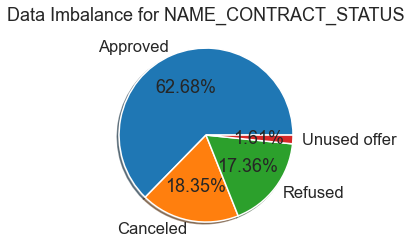

In [91]:
# Pie plot to visualize the data for TARGET variable
plot_pie('NAME_CONTRACT_STATUS',final_application,'Data Imbalance for NAME_CONTRACT_STATUS')

### Insights on Data Imbalance 

- For NAME_CONTRACT_STATUS variable, 
    We see that there are different 4 contract status types 
        1.Approved 
        2.Cancelled
        3.Refused
        4.Unused
    More than 60% of loans status are approved. Remaining status comes under 'Cancelled/Refused/Unused'.



In [92]:
# Calculating the ratio of Targeted people in the dataset

approved = round(final_application.NAME_CONTRACT_STATUS.value_counts().values[0]/len(final_application),2)*100
cancelled = round(final_application.NAME_CONTRACT_STATUS.value_counts().values[1]/len(final_application),2)*100
refused = round(final_application.NAME_CONTRACT_STATUS.value_counts().values[2]/len(final_application),2)*100
unused = round(final_application.NAME_CONTRACT_STATUS.value_counts().values[3]/len(final_application),2)*100

print("Approved:{0} Cancelled:{1} Refused:{2} Unused:{3}".format(approved,cancelled,refused,unused))

Approved:63.0 Cancelled:18.0 Refused:17.0 Unused:2.0


<a id ="30"></a>
### DIVIDING DATASET

In [93]:
# Slicing the dataset using variable NAME_CONTRACT_STATUS

CONTRACT_APPROVED=final_application[(final_application.NAME_CONTRACT_STATUS=='Approved')]

CONTRACT_CANCELED=final_application[(final_application.NAME_CONTRACT_STATUS=='Canceled')]

CONTRACT_REFUSED=final_application[(final_application.NAME_CONTRACT_STATUS=='Refused')]

CONTRACT_UNUSED=final_application[(final_application.NAME_CONTRACT_STATUS=='Unused offer')]

## DATA VISUALIZATION:

<a id ="31"></a>
### UNI-VARIATE ANALYSIS

### CATEGORICAL

In [94]:
# Defining the function to plot countplot

def unibarplot_1(data1,data2,data3,data4,col,title,label):
    fig,ax=plt.subplots(ncols=4,nrows=1, figsize=(30,12),sharey=True)

#Setting up the style and contexts
    fig.suptitle(title.upper(),weight='bold',fontsize=40)
    sns.set_style('whitegrid')
    sns.set_context('talk')
    sns.axes_style('dark')
    #sns.despine(left=True)
    
#Assigning the axes and its values 
    ax1 = sns.countplot(y=data1[col],ax=ax[0],palette='mako')
    ax1.set_xlabel('Count'.upper(),fontsize=20,weight='bold')
    ax1.set_ylabel(label.upper(),fontsize=20,weight='bold')
    ax1.set_yticklabels(ax1.get_yticklabels(),rotation=0,fontsize=20,weight='bold')
    ax1.set_xscale('log')
    ax1.set_title('For Approved'.upper())
    ax1.tick_params(labelsize=20)
    
    ax2 = sns.countplot(y=data2[col],ax=ax[1],palette='cool')
    ax2.set_xlabel('Count'.upper(),fontsize=20,weight='bold')
    ax2.set_ylabel(''.upper(),fontsize=20,weight='bold')
    ax2.set_xscale('log')
    ax2.set_title('For Cancelled'.upper())
    ax2.tick_params(labelsize=20)
    
    ax3 = sns.countplot(y=data3[col],ax=ax[2],palette='mako')
    ax3.set_xlabel('Count'.upper(),fontsize=20,weight='bold')
    ax3.set_ylabel(''.upper(),fontsize=20,weight='bold')
    ax3.set_xscale('log')
    ax3.set_title('For refused'.upper())
    ax3.tick_params(labelsize=20)
    
    ax4 = sns.countplot(y=data4[col],ax=ax[3],palette='cool')
    ax4.set_xlabel('Count'.upper(),fontsize=20,weight='bold')
    ax4.set_ylabel(''.upper(),fontsize=20,weight='bold')
    ax4.set_xscale('log')
    ax4.set_title('For unused'.upper())
    ax4.tick_params(labelsize=20)
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

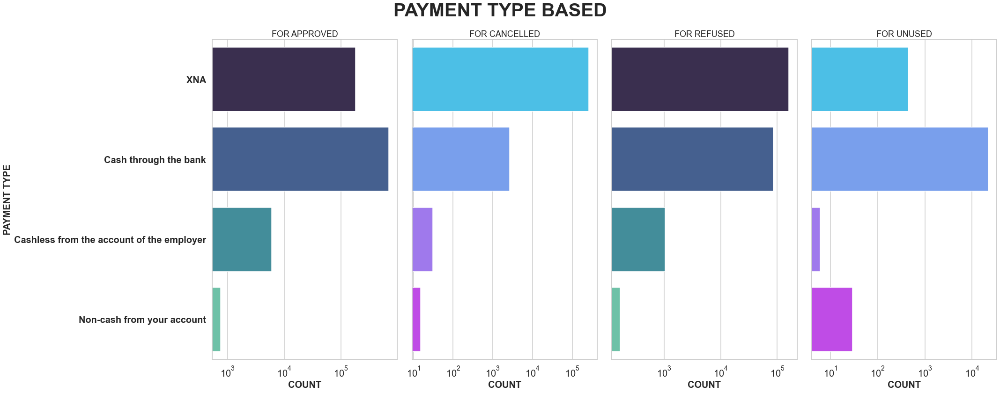

In [95]:
# Plotting the chart using function

unibarplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='NAME_PAYMENT_TYPE',title='Payment type based',label='Payment type')

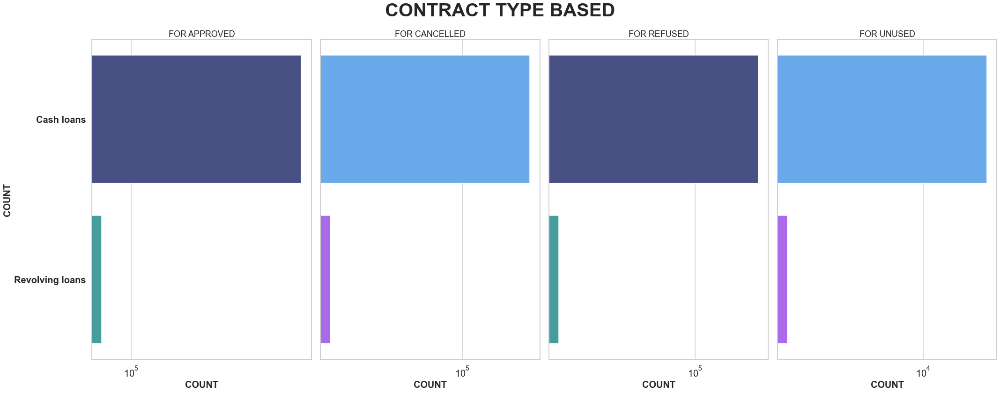

In [96]:
# Plotting the chart using function

unibarplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='NAME_CONTRACT_TYPE',title='CONTRACT TYPE based',label='Count')

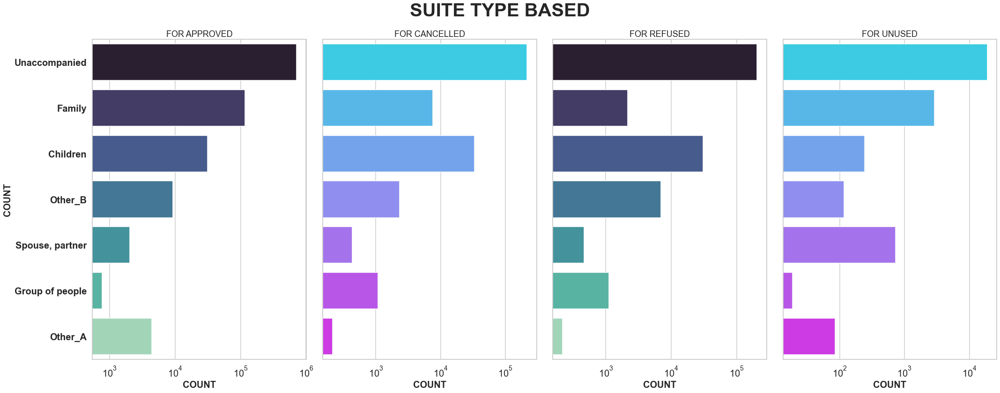

In [97]:
# Plotting the chart using function

unibarplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='NAME_TYPE_SUITE',title='suite type based',label='Count')

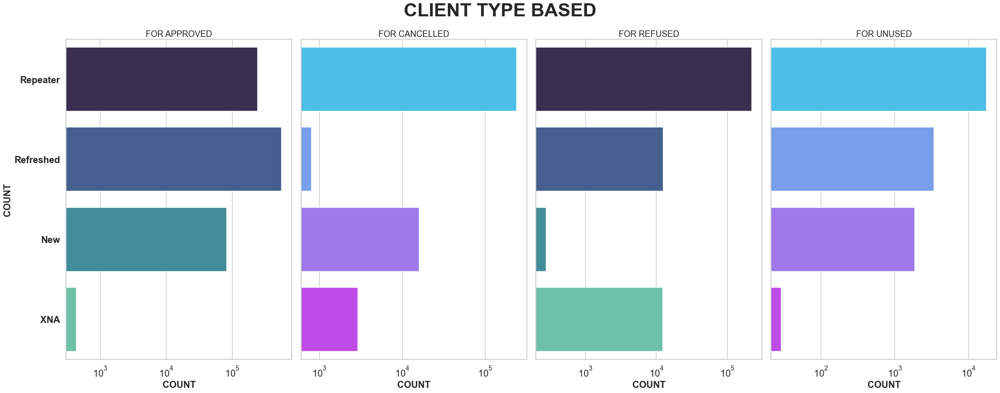

In [98]:
# Plotting the chart using function

unibarplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='NAME_CLIENT_TYPE',title='Client type based',label='Count')

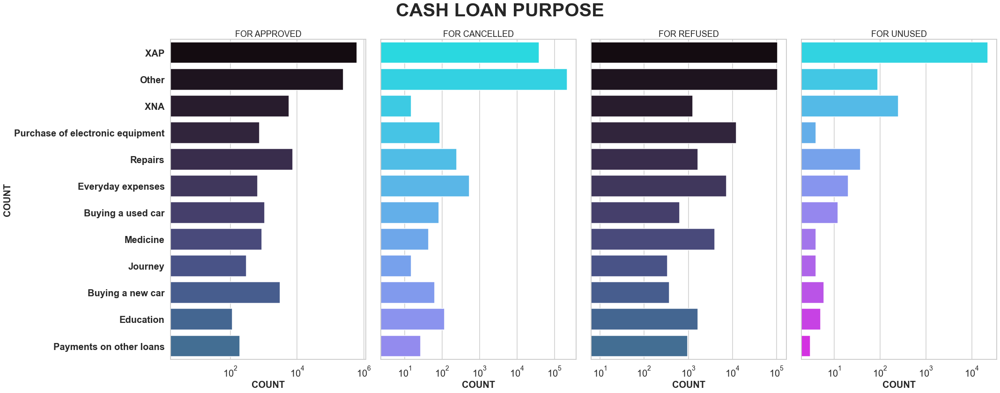

In [99]:
# Plotting the chart using function

unibarplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='NAME_CASH_LOAN_PURPOSE',title='Cash loan Purpose',label='Count')

### Insights for Univariate Analysis:

Following are the variables considered:
#### Payment Type:
    1.More Number of people/client pays through bank for ‘Approved/Refused/Unused’ Contract type.
    2.For the Cancelled Contract type, there is high number of people pay through Unknown Payment type/method.
#### Contract Type:

    1.Cash Loans (90%) are very higher when compared to Revolving Loans (10%)
    
#### Suite Type:
    1. For Higher number of cases "Unaccompanied" is repeated.
    
#### Client Type:
	1. There are different types of Client: 1. Repeater/Old 2. Refreshed 3. New 4. XNA
    2. Higher number of clients are Repeater/Old. More than 50% of clients are Repeater/Old and they approach the finance companies for applying loan regularly.
    
#### Cash Loan Purpose:
    1.In most cases the loan purpose were not known and few people got the loans for other reasons, Purchase of Electronic equipment and Repairs

<a id ="32"></a>
## CORRELATION MATRIX:

In [100]:
# Finding the correlation of a variable

corr_a=CONTRACT_APPROVED.corr()
corr_a.style.background_gradient(cmap='YlGnBu').set_precision(2)

In [101]:
# Finding the correlation of a variable

corr_c=CONTRACT_CANCELED.corr()
corr_c.style.background_gradient(cmap='YlGnBu').set_precision(2)

In [102]:
# Finding the correlation of a variable

corr_r=CONTRACT_REFUSED.corr()
corr_r.style.background_gradient(cmap='YlGnBu').set_precision(2)

In [103]:
# Finding the correlation of a variable

corr_u=CONTRACT_UNUSED.corr()
corr_u.style.background_gradient(cmap='YlGnBu').set_precision(2)

In [104]:
# Showing the best correlations

corr_a_df=corr_a.where(np.triu(np.ones(corr_a.shape),k=1).astype(bool))
corr_a_df=corr_a_df.unstack().reset_index().dropna(subset=[0])
corr_a_df.columns=['Column Variable 1','Column Variable 2','Correlation Value']
corr_a_df['Correlation Absolute']= abs(corr_a_df['Correlation Value'])
corr_a_df.sort_values(by='Correlation Absolute',ascending=False,inplace=True)
corr_a_df.iloc[0:11,:]

,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
4938,AMT_GOODS_PRICE_PREV,AMT_APPLICATION,1.000000,1.000000
4507,AGE_OF_APPLICANT,DAYS_BIRTH,0.999707,0.999707
2430,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,0.998543,0.998543
2124,FLOORSMAX_MEDI,FLOORSMAX_AVG,0.996904,0.996904
2048,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,0.994055,0.994055
4939,AMT_GOODS_PRICE_PREV,AMT_CREDIT_PREV,0.993331,0.993331
2126,FLOORSMAX_MEDI,FLOORSMAX_MODE,0.988477,0.988477
378,AMT_GOODS_PRICE,AMT_CREDIT,0.986670,0.986670
1974,FLOORSMAX_MODE,FLOORSMAX_AVG,0.985755,0.985755
1898,YEARS_BEGINEXPLUATATION_MODE,YEARS_BEGINEXPLUATATION_AVG,0.973422,0.973422


In [105]:
# Showing the best correlations

corr_c_df=corr_c.where(np.triu(np.ones(corr_c.shape),k=1).astype(bool))
corr_c_df=corr_c_df.unstack().reset_index().dropna(subset=[0])
corr_c_df.columns=['Column Variable 1','Column Variable 2','Correlation Value']
corr_c_df['Correlation Absolute']= abs(corr_c_df['Correlation Value'])
corr_c_df.sort_values(by='Correlation Absolute',ascending=False,inplace=True)
corr_c_df.iloc[0:11,:]


,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
4938,AMT_GOODS_PRICE_PREV,AMT_APPLICATION,1.000000,1.000000
4507,AGE_OF_APPLICANT,DAYS_BIRTH,0.999707,0.999707
2430,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,0.998631,0.998631
4863,AMT_CREDIT_PREV,AMT_APPLICATION,0.996822,0.996822
2124,FLOORSMAX_MEDI,FLOORSMAX_AVG,0.996744,0.996744
2048,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,0.993967,0.993967
4939,AMT_GOODS_PRICE_PREV,AMT_CREDIT_PREV,0.991644,0.991644
2126,FLOORSMAX_MEDI,FLOORSMAX_MODE,0.988770,0.988770
1974,FLOORSMAX_MODE,FLOORSMAX_AVG,0.985930,0.985930
378,AMT_GOODS_PRICE,AMT_CREDIT,0.985910,0.985910


In [106]:
# Showing the best correlations

corr_r_df=corr_r.where(np.triu(np.ones(corr_r.shape),k=1).astype(bool))
corr_r_df=corr_r_df.unstack().reset_index().dropna(subset=[0])
corr_r_df.columns=['Column Variable 1','Column Variable 2','Correlation Value']
corr_r_df['Correlation Absolute']= abs(corr_r_df['Correlation Value'])
corr_r_df.sort_values(by='Correlation Absolute',ascending=False,inplace=True)
corr_r_df.iloc[0:11,:]

,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
4507,AGE_OF_APPLICANT,DAYS_BIRTH,0.999711,0.999711
4938,AMT_GOODS_PRICE_PREV,AMT_APPLICATION,0.999666,0.999666
2430,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,0.998548,0.998548
2124,FLOORSMAX_MEDI,FLOORSMAX_AVG,0.997172,0.997172
2048,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,0.994698,0.994698
4939,AMT_GOODS_PRICE_PREV,AMT_CREDIT_PREV,0.991842,0.991842
2126,FLOORSMAX_MEDI,FLOORSMAX_MODE,0.988717,0.988717
1974,FLOORSMAX_MODE,FLOORSMAX_AVG,0.986003,0.986003
378,AMT_GOODS_PRICE,AMT_CREDIT,0.985178,0.985178
4863,AMT_CREDIT_PREV,AMT_APPLICATION,0.983684,0.983684


In [107]:
# Showing the best correlations

corr_u_df=corr_u.where(np.triu(np.ones(corr_u.shape),k=1).astype(bool))
corr_u_df=corr_u_df.unstack().reset_index().dropna(subset=[0])
corr_u_df.columns=['Column Variable 1','Column Variable 2','Correlation Value']
corr_u_df['Correlation Absolute']= abs(corr_u_df['Correlation Value'])
corr_u_df.sort_values(by='Correlation Absolute',ascending=False,inplace=True)
corr_u_df.iloc[0:11,:]

,Column Variable 1,Column Variable 2,Correlation Value,Correlation Absolute
4938,AMT_GOODS_PRICE_PREV,AMT_APPLICATION,1.000000,1.000000
4939,AMT_GOODS_PRICE_PREV,AMT_CREDIT_PREV,0.999967,0.999967
4863,AMT_CREDIT_PREV,AMT_APPLICATION,0.999758,0.999758
4507,AGE_OF_APPLICANT,DAYS_BIRTH,0.999644,0.999644
2430,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,0.998485,0.998485
2124,FLOORSMAX_MEDI,FLOORSMAX_AVG,0.997626,0.997626
2048,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,0.989668,0.989668
2126,FLOORSMAX_MEDI,FLOORSMAX_MODE,0.989190,0.989190
1974,FLOORSMAX_MODE,FLOORSMAX_AVG,0.987644,0.987644
378,AMT_GOODS_PRICE,AMT_CREDIT,0.986124,0.986124


### Insights on Correlation

Correlation for 4 contract/loan status Datasets:
1. We could see highly positive correlation between AMT_CREDIT, AMT_ANNUITY and AMT_GOODS_PRICE, AMT_APPLICATION, CNT_PAYMENT and CNT_FAM_MEMBERS
2. We can see that REGION_RATING_CLIENT and REGION_POPULATION_RELATIVE, EXT_SOURCE_2 and REGION_RATING_CLIENT are Negatively correlated


### UNI - VARIATE - CONTINUOUS PLOT

In [108]:
# Defining boxplot with needed parameters
def uniboxplot_1(data1,data2,data3,data4,col,title,label):
    fig,ax=plt.subplots(ncols=4,nrows=1, figsize=(15,7),sharey=True)

#Setting up the style and contexts
    sns.set_style('whitegrid')
    sns.set_context('talk')
    #sns. despine(left = True)
    fig.suptitle(title.upper(),weight='bold',fontsize=20)

#Assigning the axes and its values 
    ax1 = sns.boxplot(data=data1,x=col,orient='v',ax=ax[0],palette='mako')
    ax1.set_yscale('log')
    ax1.set_ylabel('Count'.upper())
    ax1.set_xlabel(label.upper())
    ax1.set_title('For Approved'.upper())
    
    ax2 = sns.boxplot(data=data2,x=col,orient='v',ax=ax[1],palette='cool')
    ax2.set_yscale('log')
    ax2.set_ylabel('')
    ax2.set_xlabel(label.upper())
    ax2.set_title('For Cancelled'.upper())
    
    ax3 = sns.boxplot(data=data3,x=col,orient='v',ax=ax[2],palette='mako')
    ax3.set_yscale('log')
    ax3.set_ylabel('Count'.upper())
    ax3.set_xlabel(label.upper())
    ax3.set_title('For Refused'.upper())
    
    ax4 = sns.boxplot(data=data4,x=col,orient='v',ax=ax[3],palette='cool')
    ax4.set_yscale('log')
    ax4.set_ylabel('')
    ax4.set_xlabel(label.upper())
    ax4.set_title('For Unused'.upper())
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

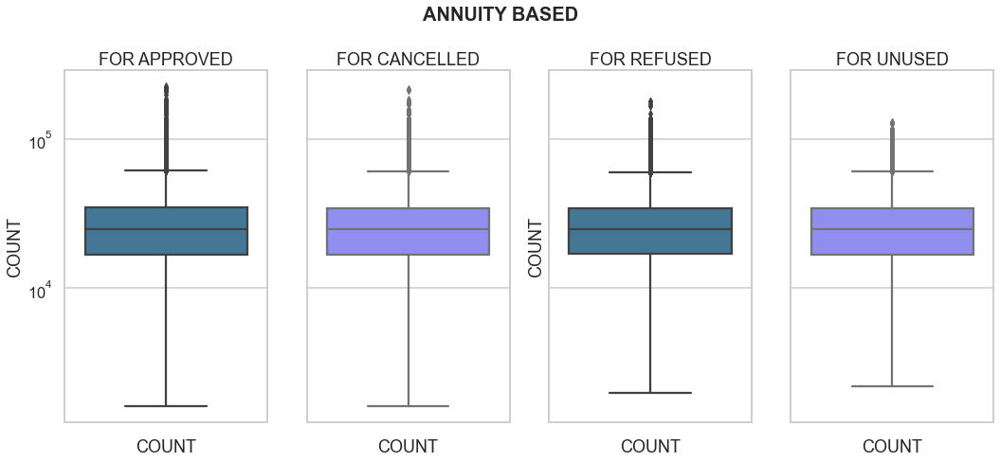

In [109]:
# Plotting the chart using function

uniboxplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='AMT_ANNUITY',title='Annuity based',label='Count')

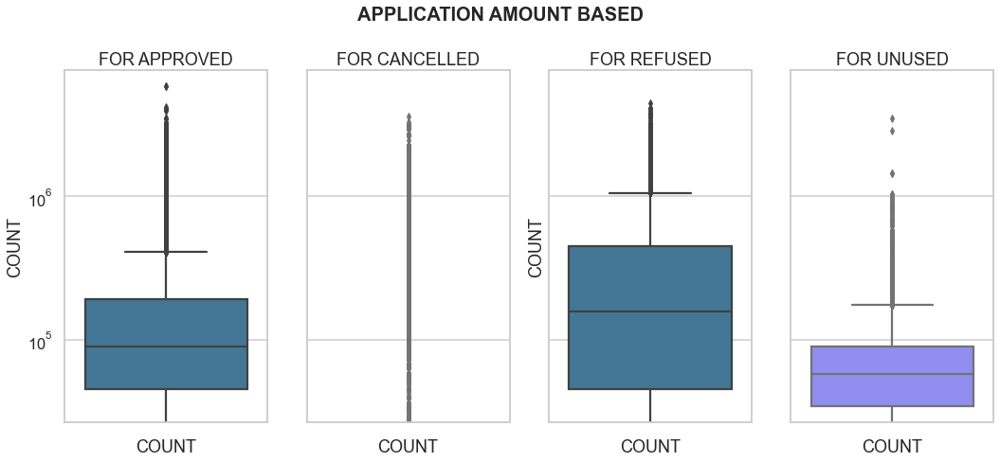

In [110]:
# Plotting the chart using function

uniboxplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='AMT_APPLICATION',title='Application amount based',label='Count')

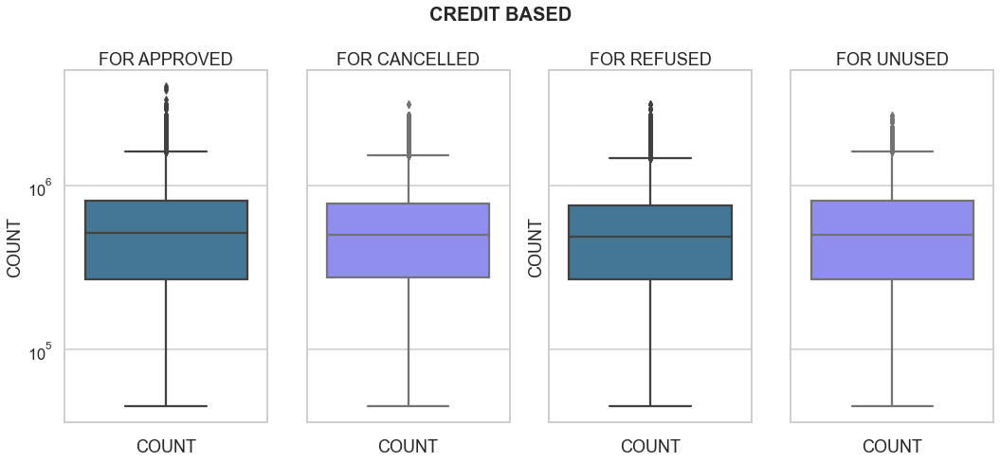

In [111]:
# Plotting the chart using function

uniboxplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='AMT_CREDIT',title='credit based',label='Count')

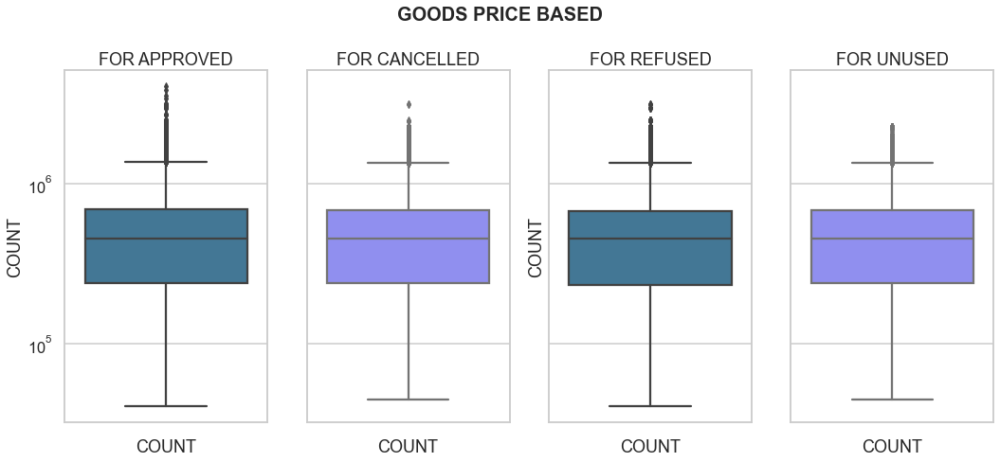

In [112]:
# Plotting the chart using function

uniboxplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='AMT_GOODS_PRICE',title='goods price based',label='Count')

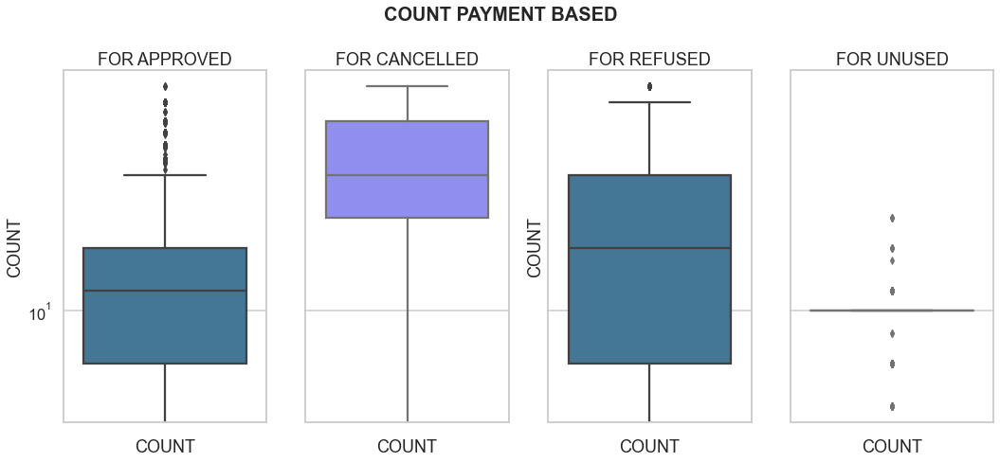

In [113]:
# Plotting the chart using function

uniboxplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,col='CNT_PAYMENT',title='count payment based',label='Count')

### Insights for Univariate Continuous:

Annuity Amount:
    Average Annuity amount is coming around 25k.

Application Amount:
    For Approved Loans, the loan applied amount is in the range of 100K – 1000K.
    For Refused Loans, Loan applied amount is higher when compared  to others.
    For Unused Loans, most number of the cases are having the less Loan applied amount.


<a id ="33"></a>
## BI - VARIATE ANALYSIS 


### CONTINUOUS - CATEGORICAL

In [114]:
# Creating a function with necessary parameters,setting up styles and axes.

def bivariateplot_1(data1,data2,data3,data4,colx,coly,hue,title,xlabel,ylabel,legend):
    fig ,axes=plt.subplots(ncols=2,nrows=2,figsize=(30,20),sharex = True,sharey=True)
    sns.set_style('whitegrid')
    sns.set_context('talk')
    sns.axes_style('dark')
    #sns. despine(left = True)
    
    ax1=sns.boxplot(data =data1, x=colx,y=coly, hue =hue,orient='h',ax=axes[0,0],palette='mako')
    ax1.set_title(title.upper()+" - Approved".upper(),weight='bold',fontsize=20)
    ax1.set_xlabel(xlabel.upper(),fontsize=26,weight='bold')
    ax1.set_ylabel(ylabel.upper(),fontsize=26,weight='bold')
    ax1.set_yticklabels(ax1.get_yticklabels(),fontsize=20)
    ax1.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax1.set_xscale('log')
    ax1.tick_params(labelsize=18)
    
    ax2=sns.boxplot(data =data2, x=colx,y=coly, hue =hue,orient='h',ax=axes[0,1],palette='cool')
    ax2.set_title(title.upper()+" - Cancelled".upper(),weight='bold',fontsize=20)
    ax2.set_xlabel(xlabel.upper(),fontsize=26,weight='bold')
    ax2.set_ylabel(''.upper(),fontsize=26,weight='bold')
    ax2.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax2.set_xscale('log')
    ax2.tick_params(labelsize=18)
    
    ax3=sns.boxplot(data =data3, x=colx,y=coly, hue =hue,orient='h',ax=axes[1,0],palette='mako')
    ax3.set_title(title.upper()+" - refused".upper(),weight='bold',fontsize=20)
    ax3.set_xlabel(xlabel.upper(),fontsize=26,weight='bold')
    ax3.set_ylabel(ylabel.upper(),fontsize=26,weight='bold')
    ax3.set_yticklabels(ax1.get_yticklabels(),fontsize=20)
    ax3.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax3.set_xscale('log')
    ax3.tick_params(labelsize=18)
    
    ax4=sns.boxplot(data =data4, x=colx,y=coly, hue =hue,orient='h',ax=axes[1,1],palette='cool')
    ax4.set_title(title.upper()+" - unused".upper(),weight='bold',fontsize=20)
    ax4.set_xlabel(xlabel.upper(),fontsize=26,weight='bold')
    ax4.set_ylabel(''.upper(),fontsize=26,weight='bold')
    ax4.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax4.set_xscale('log')
    ax4.tick_params(labelsize=18)
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

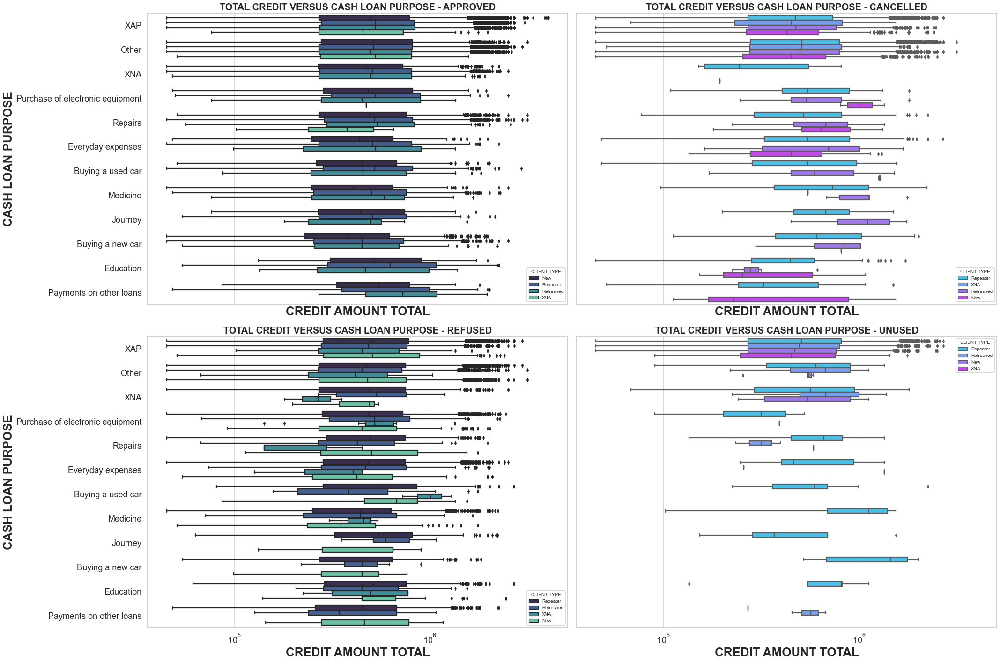

In [115]:
# Plotting the chart using function

bivariateplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_CREDIT'
                ,coly='NAME_CASH_LOAN_PURPOSE',hue='NAME_CLIENT_TYPE',title='total Credit versus Cash Loan Purpose',xlabel='Credit amount total'
                ,ylabel='Cash Loan Purpose',legend='client type')

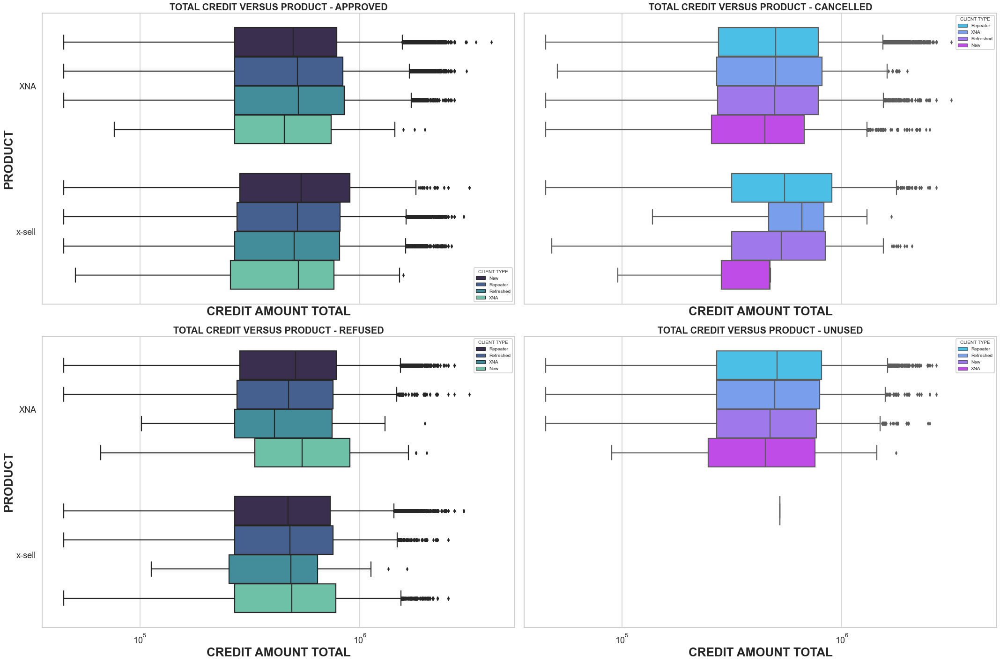

In [116]:
# Plotting the chart using function

bivariateplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_CREDIT'
                ,coly='NAME_PRODUCT_TYPE',hue='NAME_CLIENT_TYPE',title='total Credit versus product',xlabel='Credit Amount total'
                ,ylabel='Product',legend='client type')

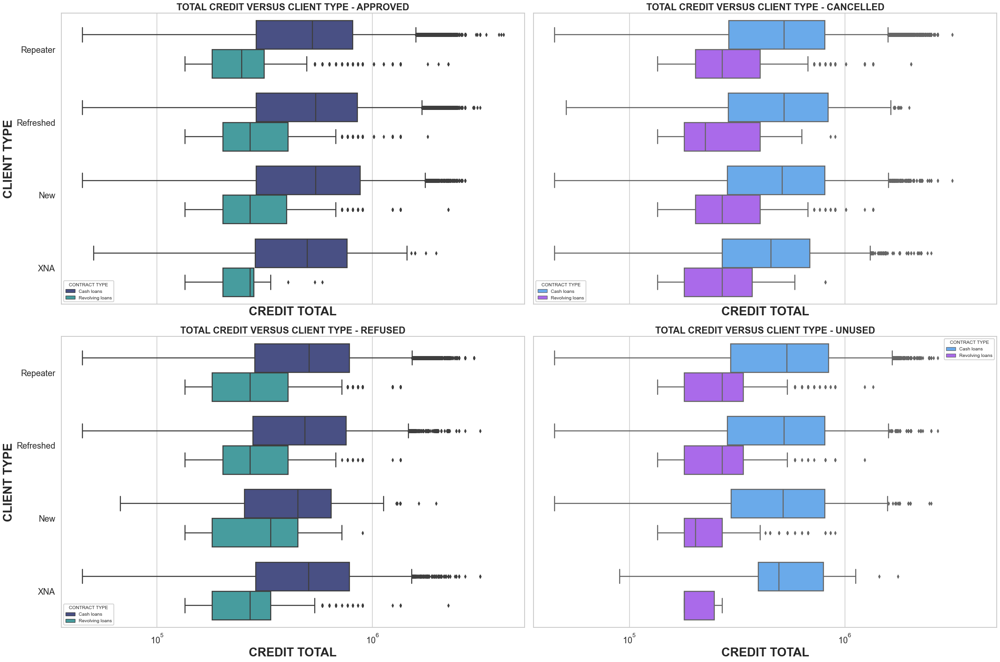

In [117]:
# Plotting the chart using function

bivariateplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_CREDIT'
                ,coly='NAME_CLIENT_TYPE',hue='NAME_CONTRACT_TYPE',title='total Credit versus client type',xlabel='credit total'
                ,ylabel='client type',legend='contract type')


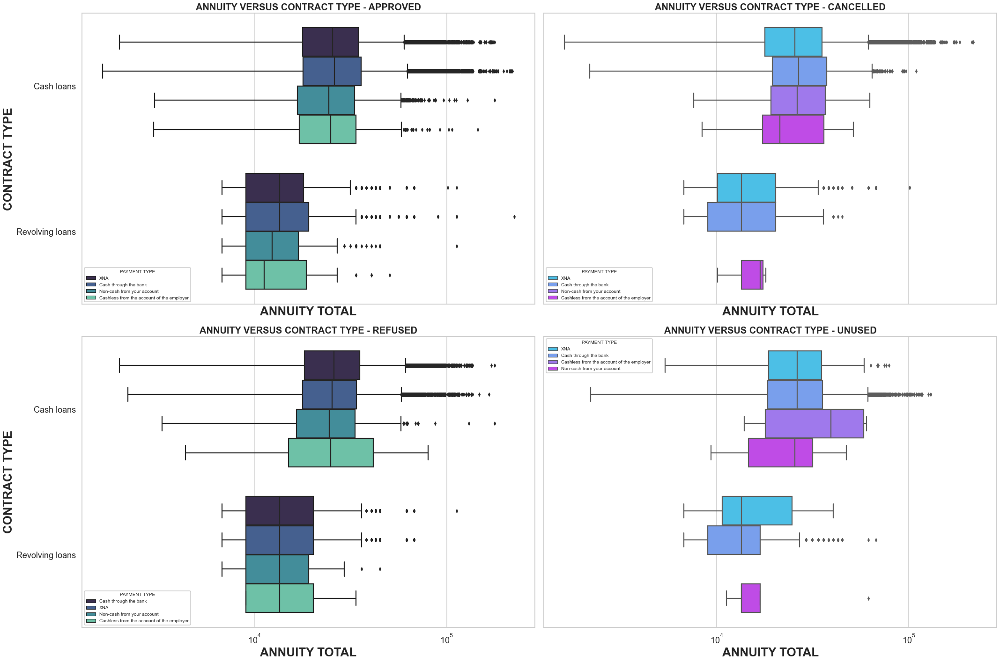

In [118]:
# Plotting the chart using function

bivariateplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_ANNUITY'
                ,coly='NAME_CONTRACT_TYPE',hue='NAME_PAYMENT_TYPE',title='annuity versus contract type',xlabel='Annuity total'
                ,ylabel='contract type',legend='Payment type')


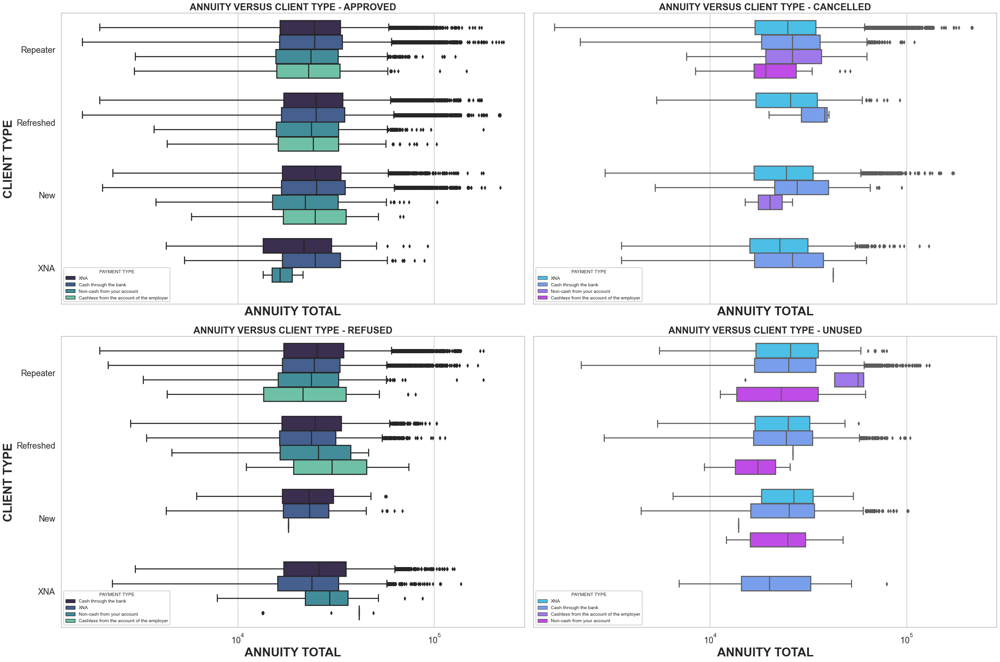

In [119]:
# Plotting the chart using function

bivariateplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_ANNUITY'
               ,coly='NAME_CLIENT_TYPE',hue='NAME_PAYMENT_TYPE',title='annuity versus client type',xlabel='annuity total'
                ,ylabel='client type',legend='Payment type')

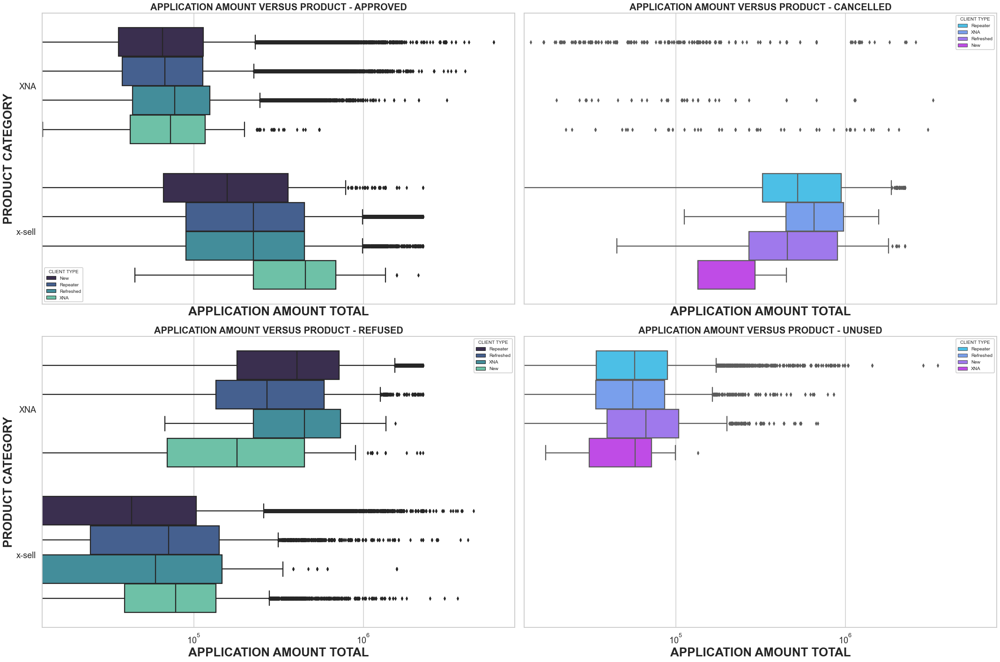

In [120]:
# Plotting the chart using function

bivariateplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_APPLICATION'
                ,coly='NAME_PRODUCT_TYPE',hue='NAME_CLIENT_TYPE',title='application amount versus product',xlabel='application amount total'
                ,ylabel='product category',legend='client type')

### Insights for Bivariate Continuous - Categorical:

#### Credit Amount vs Cash Loan Purpose:
    1.In most cases, Credit amount is higher and purpose of the loan were not known and few people got the loans for other reasons, Purchase of Electronic equipment and Repairs.
    2. There is also a higher number of Cases were the loans are cancelled when the purpose of the loan is not  known.
    
#### Credit Amount vs Client Type:
    Higher number of clients are Repeater/Old. More than 50% of clients are Repeater/Old and they approach the finance companies for applying loan regularly.
    Cash Loans (90%) are very higher when compared to Revolving Loans (10%)  

#### Annuity vs Contract Type:
    Annuity amount is higher For Cash Loans when compared to Revolving Loans.
    For Cash Loans more number of people made the payment through ‘Cash through the Bank’ followed by ‘Non-Cash through Account’.

#### Annuity vs Client Type:
    Annuity amount is higher for Repeater/Refreshed Client. Most frequent payment mode chosen is ‘Cash through the Bank’ followed by ‘Non-Cash through Account’.
    For Cash Loans more number of people made the payment through ‘Cash through the Bank’ followed by ‘Non-Cash through Account’.


### BI - VARIATE 

### Continuous - Continuous

In [121]:
# Defining the function to plot scatterplot

def biscatterplot_1(data1,data2,data3,data4,colx,coly,hue,title,xlabel,ylabel,legend):
    fig ,axes=plt.subplots(2,2,figsize=(20,10),sharex = True,sharey=True)
    sns.set_style('whitegrid')
    sns.set_context('talk')
    sns.axes_style('dark')
    #sns. despine(left = True)
    
    ax1=sns.scatterplot(data =data1, x=colx,y=coly, hue =hue,ax=axes[0,0],palette='mako')
    ax1.set_title(title.upper()+" - approved".upper(),weight='bold',fontsize=20)
    ax1.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax1.set_ylabel(ylabel.upper(),fontsize=16,weight='bold')
    ax1.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax1.set_xscale('log')
    ax1.set_yscale('log')
    ax1.tick_params(labelsize=14)
    
    ax2=sns.scatterplot(data =data2, x=colx,y=coly, hue =hue,ax=axes[0,1],palette='cool')
    ax2.set_title(title.upper()+" - cancelled".upper(),weight='bold',fontsize=20)
    ax2.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax2.set_ylabel(''.upper(),fontsize=16,weight='bold')
    ax2.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax2.set_xscale('log')
    ax2.set_yscale('log')
    ax2.tick_params(labelsize=14)
    
    ax3=sns.scatterplot(data =data3, x=colx,y=coly, hue =hue,ax=axes[1,0],palette='mako')
    ax3.set_title(title.upper()+" - refused".upper(),weight='bold',fontsize=20)
    ax3.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax3.set_ylabel(ylabel.upper(),fontsize=16,weight='bold')
    ax3.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax3.set_xscale('log')
    ax3.set_yscale('log')
    ax3.tick_params(labelsize=14)
    
    ax4=sns.scatterplot(data =data4, x=colx,y=coly, hue =hue,ax=axes[1,1],palette='cool')
    ax4.set_title(title.upper()+" - unused".upper(),weight='bold',fontsize=20)
    ax4.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax4.set_ylabel(''.upper(),fontsize=16,weight='bold')
    ax4.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax4.set_xscale('log')
    ax4.set_yscale('log')
    ax4.tick_params(labelsize=14)
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

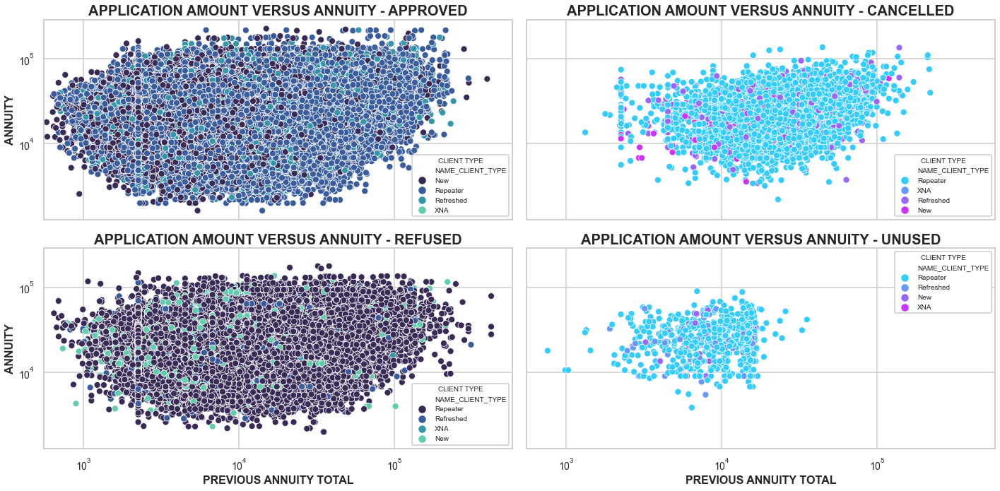

In [122]:
# Plotting the chart using function

biscatterplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_ANNUITY_PREV'
                ,coly='AMT_ANNUITY',hue='NAME_CLIENT_TYPE',title='application amount versus annuity',xlabel='previous annuity total'
                ,ylabel='annuity',legend='client type')

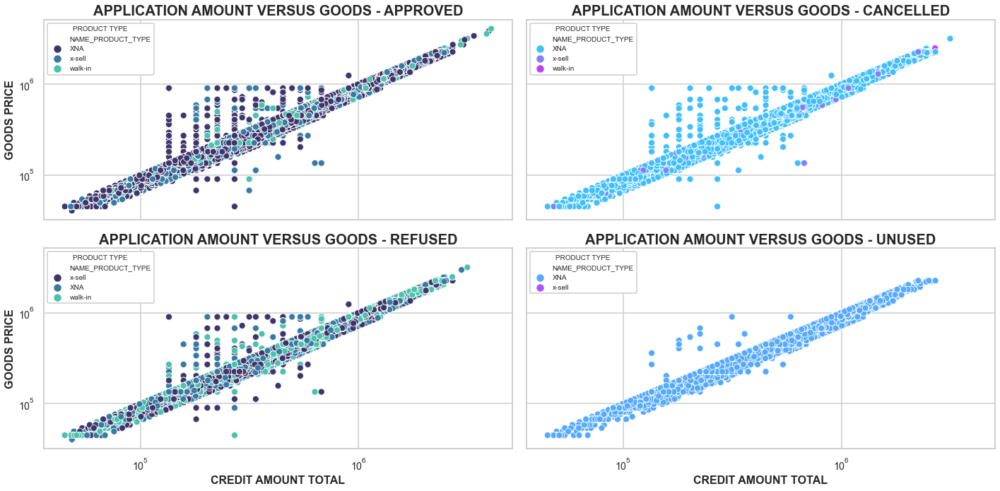

In [123]:
# Plotting the chart using function

biscatterplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_CREDIT'
                ,coly='AMT_GOODS_PRICE',hue='NAME_PRODUCT_TYPE',title='application amount versus goods',xlabel='Credit amount total'
                ,ylabel='Goods Price',legend='product type')

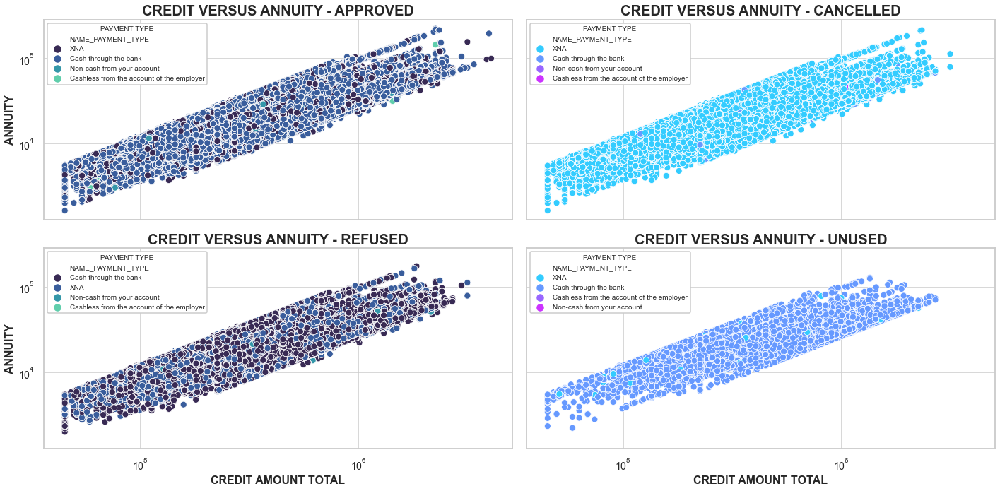

In [124]:
# Plotting the chart using function

biscatterplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AMT_CREDIT'
                ,coly='AMT_ANNUITY',hue='NAME_PAYMENT_TYPE',title='credit versus annuity',xlabel='credit amount total'
                ,ylabel='annuity',legend='payment type')

### Insights for Bivariate Continuous - Continuous:

Following variables are considered:

#### Annuity Current Amount vs Annuity Previous Amount:
    There is high amount of cluster between the Annuity amount in the range of 10K and 100K.
    
#### Credit Amount vs Goods Price
There is high amount of cluster between the Credit amount and Goods Price in the range of 100K and 100K.

#### Credit Amount vs Annuity
There is high amount of cluster between the Credit amount and Annuity Amount in the range of 100K and 100K.


## BI - VARIATE 

### Categorical - Categorical

In [125]:
# Defining the function to plot countplot

def bicountplot_1(data1,data2,data3,data4,colx,hue,title,xlabel,legend):
    fig ,axes=plt.subplots(2,2,figsize=(20,10),sharex = True,sharey=True)
    sns.set_style('whitegrid')
    sns.set_context('talk')
    sns.axes_style('dark')
    
    ax1=sns.countplot(data =data1, x=colx, hue =hue,ax=axes[0,0],palette='mako')
    ax1.set_title(title.upper()+" - approved".upper(),weight='bold',fontsize=20)
    ax1.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax1.set_ylabel('count'.upper(),fontsize=16,weight='bold')
    ax1.set_xticklabels(ax1.get_xticklabels(),rotation=60,fontsize=14)
    ax1.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax1.set_yscale('log')
    ax1.tick_params(labelsize=14)
    
    ax2=sns.countplot(data =data2, x=colx, hue =hue,ax=axes[0,1],palette='cool')
    ax2.set_title(title.upper()+" - cancelled".upper(),weight='bold',fontsize=20)
    ax2.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax2.set_ylabel(''.upper(),fontsize=16,weight='bold')
    ax2.set_xticklabels(ax2.get_xticklabels(),rotation=60,fontsize=14)
    ax2.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax2.set_yscale('log')
    ax2.tick_params(labelsize=14)
    
    ax3=sns.countplot(data =data3, x=colx, hue =hue,ax=axes[1,0],palette='mako')
    ax3.set_title(title.upper()+" - refused".upper(),weight='bold',fontsize=20)
    ax3.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax3.set_ylabel('count'.upper(),fontsize=16,weight='bold')
    ax3.set_xticklabels(ax3.get_xticklabels(),rotation=60,fontsize=14)
    ax3.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax3.set_yscale('log')
    ax3.tick_params(labelsize=14)
    
    ax4=sns.countplot(data =data4, x=colx, hue =hue,ax=axes[1,1],palette='cool')
    ax4.set_title(title.upper()+" - unused".upper(),weight='bold',fontsize=20)
    ax4.set_xlabel(xlabel.upper(),fontsize=16,weight='bold')
    ax4.set_ylabel(''.upper(),fontsize=16,weight='bold')
    ax4.set_xticklabels(ax4.get_xticklabels(),rotation=60,fontsize=14)
    ax4.legend(title=legend.upper(),loc=0,frameon=True,framealpha=1, fancybox=True,title_fontsize=10,fontsize=10)
    ax4.set_yscale('log')
    ax4.tick_params(labelsize=14)
    
    plt.tight_layout()
#     plt.savefig(title)
    plt.show()

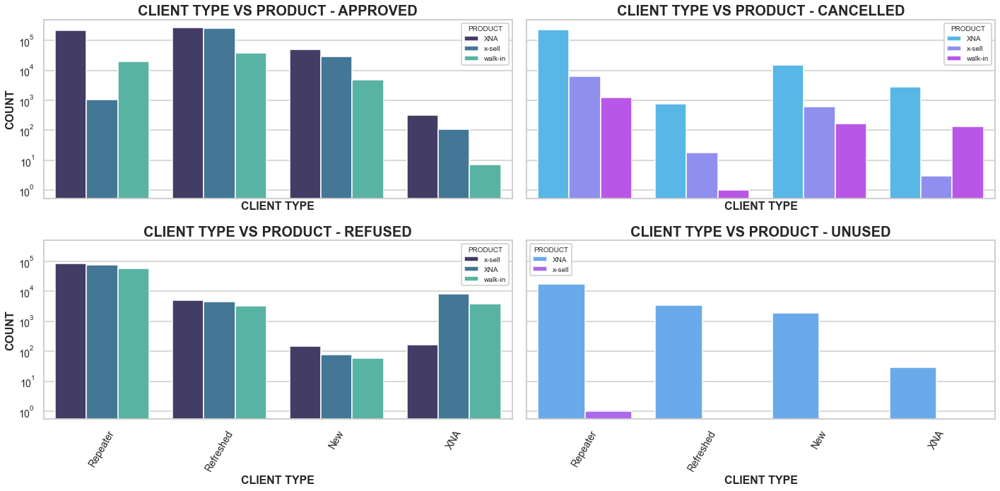

In [126]:
# Plotting the chart using function

bicountplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='NAME_CLIENT_TYPE'
              ,hue='NAME_PRODUCT_TYPE',title='Client type vs product',xlabel='client type',legend='product')

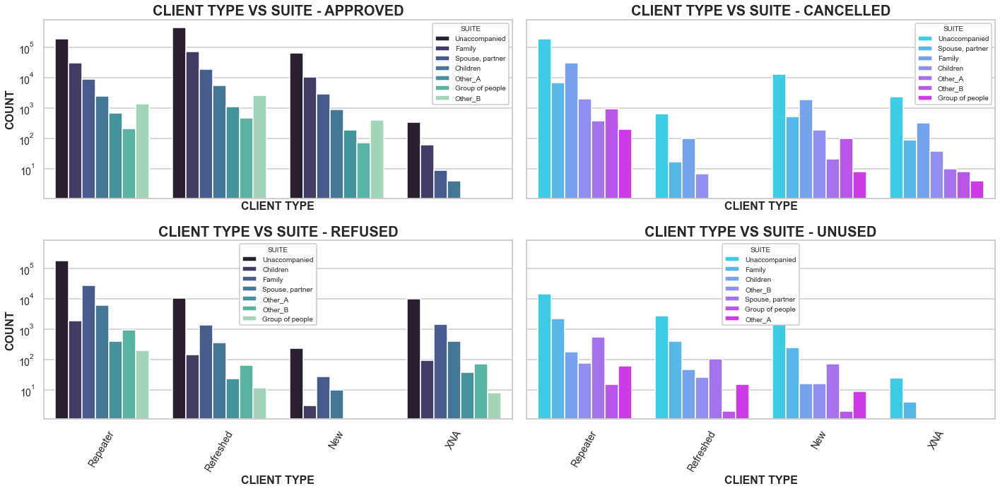

In [127]:
# Plotting the chart using function

bicountplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='NAME_CLIENT_TYPE'
              ,hue='NAME_TYPE_SUITE',title='Client type vs suite',xlabel='client type',legend='suite')


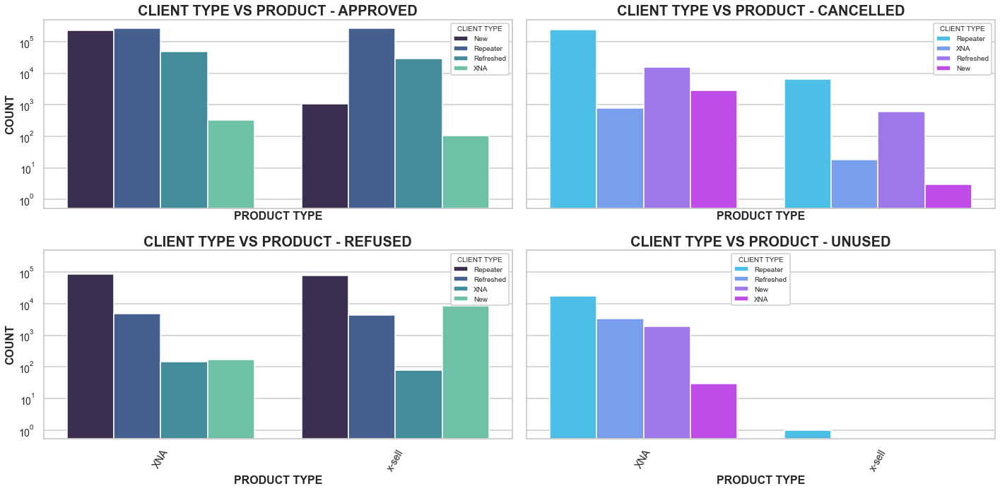

In [128]:
# Plotting the chart using function

bicountplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='NAME_PRODUCT_TYPE'
              ,hue='NAME_CLIENT_TYPE',title='Client type vs product',xlabel='product type',legend='client type')

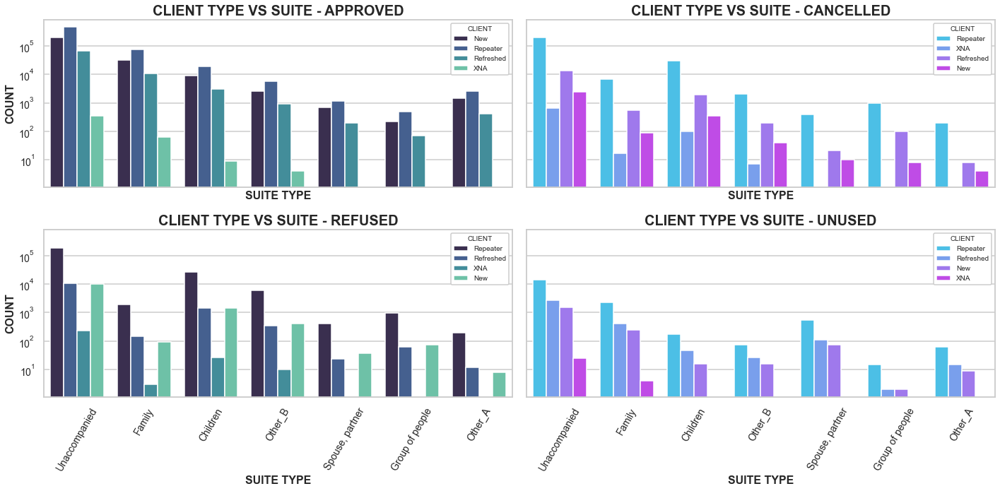

In [129]:
# Plotting the chart using function

bicountplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='NAME_TYPE_SUITE'
              ,hue='NAME_CLIENT_TYPE',title='Client type vs suite',xlabel='suite type',legend='client')

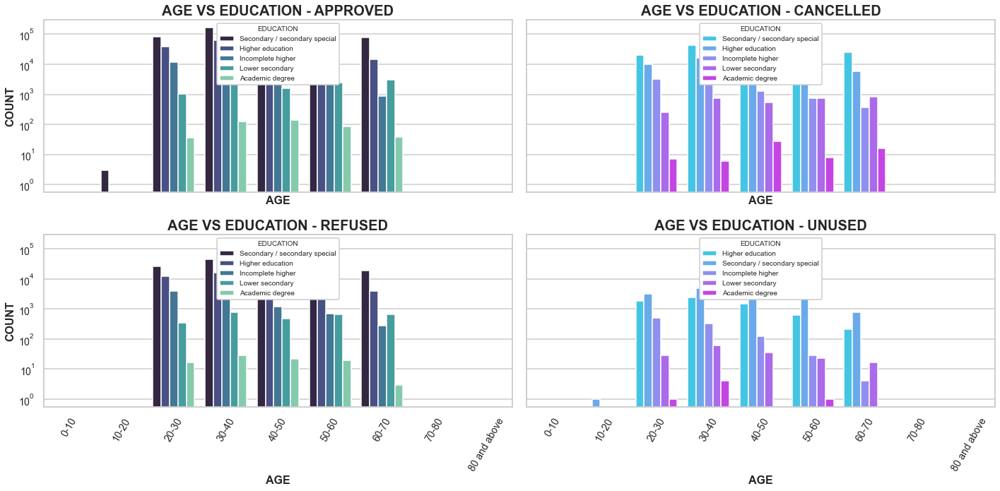

In [130]:
# Plotting the chart using function

bicountplot_1(data1=CONTRACT_APPROVED,data2=CONTRACT_CANCELED,data3=CONTRACT_REFUSED,data4=CONTRACT_UNUSED,colx='AGE_RANGE'
              ,hue='NAME_EDUCATION_TYPE',title='Age vs education',xlabel='age',legend='education')

### Insights for Bivariate Categorical - Categorical:

1.Repeater Client type have got their most of their loan application approved while comparing to others.

2.Likewise, New applicants are the least cancelled loan applicants over the dataset.

3.Repeater with XNA(not applicable) can be seen across all the contract categories, while x-sell category would come next to that.

4.Group of people suite type is the one that have been refused more number of applications.

5.Repeater with Unaccompanied suite types of application have been refused in more numbers by banks, and they are only the one who have been approved too.

6.Age range of 30-40 with Secondary Special education type given the more number of approved loans

7.The age range is majorly between 20 and 70. Less than 20 and More than 70 are only few who have applied for the loan


In [131]:
# Pivoting to get better insights

piv1=pd.pivot_table(final_application,index='AGE_RANGE')
appli_credit = piv1[['AMT_CREDIT','AMT_CREDIT_PREV','AMT_INCOME_TOTAL','AMT_ANNUITY','AMT_ANNUITY_PREV','AMT_APPLICATION']]

### Age-Based Research

In [132]:
# Parsing the varibles to get plotly visual

fig = go.Figure()
fig.add_trace(go.Bar(x=appli_credit.index.values, y=appli_credit.AMT_INCOME_TOTAL,name='Total Income'.upper()))
fig.add_trace(go.Bar(x=appli_credit.index.values, y=appli_credit.AMT_CREDIT,name='Current Credit'.upper()))
fig.add_trace(go.Bar(x=appli_credit.index.values, y=appli_credit.AMT_CREDIT_PREV,name='Previous Credit'.upper()))
fig.add_trace(go.Bar(x=appli_credit.index.values, y=appli_credit.AMT_ANNUITY,name='Current Annuity'.upper()))
fig.add_trace(go.Bar(x=appli_credit.index.values, y=appli_credit.AMT_ANNUITY_PREV,name='Previous Annuity'.upper()))
fig.add_trace(go.Bar(x=appli_credit.index.values, y=appli_credit.AMT_APPLICATION,name='Previous Application Amount'.upper()))


fig.update_layout(barmode='group', title_text='AGE BASED RESEARCH')
fig.show()

### Insights for Age-Based Research:

1.Income totals have been more in the space of 40 and 50 age range , followed by 30-40 and 20-30

2.Even Credit totals have been more in the space of 40 and 50 age range, followed by 50-60 and 30-40

3.50-60 age group have already been loaded with previous credits, followed by 40-50 and 30-40

4.Current and Previous Annuity values are lesser in terms of all age groups

5.Higher previous loan amount has been offered to 50-60 age group , followed by 40-50


### Loans Based Research:

In [133]:
# Pivoting to get better insights

piv2=pd.pivot_table(final_application,index='NAME_CASH_LOAN_PURPOSE')
loan_pur = piv2[['AGE_OF_APPLICANT','AMT_CREDIT_PREV','AMT_CREDIT','AMT_INCOME_TOTAL','AMT_GOODS_PRICE','AMT_GOODS_PRICE_PREV','AMT_APPLICATION']]

In [134]:
# Parsing the varibles to get plotly visual

fig = go.Figure()
fig.add_trace(go.Bar(x=loan_pur.index.values[0:10], y=loan_pur.AGE_OF_APPLICANT,name='Age'.upper()))
fig.add_trace(go.Bar(x=loan_pur.index.values[0:10], y=loan_pur.AMT_INCOME_TOTAL,name='Total Income'.upper()))
fig.add_trace(go.Bar(x=loan_pur.index.values[0:10], y=loan_pur.AMT_CREDIT_PREV,name='Previous Credit'.upper()))
fig.add_trace(go.Bar(x=loan_pur.index.values[0:10], y=loan_pur.AMT_GOODS_PRICE_PREV,name='Previous goods price'.upper()))
fig.add_trace(go.Bar(x=loan_pur.index.values[0:10], y=loan_pur.AMT_CREDIT,name='current credit'.upper()))
fig.add_trace(go.Bar(x=loan_pur.index.values[0:10], y=loan_pur.AMT_GOODS_PRICE,name='current goods price'.upper()))
fig.add_trace(go.Bar(x=loan_pur.index.values[0:10], y=loan_pur.AMT_APPLICATION,name='Previous Application Amount'.upper()))


fig.update_layout(barmode='relative', title_text='Purpose of loans BASED RESEARCH'.upper())
fig.show()

### Insights for Loans Based Research
1.People applied for Business development have been seen with more current credits, followed by buying a garage

2.People who applied for buying a car have already been with larger number of previous credits , followed by buying a new home

3.Even people who applied for buying a car have already been with larger number of previous goods price

4.Buying a holiday home is the reason given by people with larger amount of current credit

5.Buying a car and buying a holiday home loan purposes are the higher amount in previous application amount and current goods price


<a id ="34"></a>
## CONCLUSION:

a. Based on the Exploratory Data Analysis performed on the Current Application and Final Application datasets, identified key variables that provides insights/details on Client Attributes and Loan attributes. 
b. Top 10 variables that can be used to design a set of rules for predicting whether the Client/Customer would be able to repay the loan amount or would be having difficulty in Loan repayment. 

    1. Income Total
    2. Income Type [Employment Category]
    3. Credit/Annuity Amount
    4. Loan/Contract Status [Previous Application]
    5. Previous Credit Amount
    6. Education Type
    7. Family Status
    8. Cash Loan Purpose
    9. Housing Type
    10. Age of Applicant
